In [127]:
%matplotlib inline
import matplotlib
import matplotlib.pyplot as plt
import numpy as np

In [128]:
import skimage 
from skimage import io, filters

In [129]:
import glob
import os

path = str(os.getcwd())
path = path + "/Drops/All/*.jpg"
print(path)

archivos = glob.glob(path)
print (len(archivos))


/Users/jorgeriverosvergara/Desktop/Universidad/10ºSemestre/Biologia Sintetica y Prototipado de Funciones Artificiales/Proyecto/biosync/Drops/All/*.jpg
44


In [ ]:
filename = archivos[8]
arname = filename[145:]

print(filename)
print(arname)

In [ ]:
imagefile = plt.imread(filename)
print(imagefile.shape)
plt.imshow(imagefile, aspect='equal')

In [ ]:
image_sum = imagefile.sum(axis=2)
plt.imshow(image_sum)
plt.colorbar()

In [ ]:
from skimage.filters import gaussian
g_image = gaussian(imagefile[:, 220:2100, 1], 1)
ng_image = (g_image-g_image.min())/(g_image.max()-g_image.min())

plt.imshow(ng_image)
plt.colorbar()

In [ ]:
import skimage.feature as skfeat
A = skfeat.blob_log(ng_image, min_sigma=5.0, max_sigma=75.0, num_sigma=15, threshold=0.16, overlap=0.8)

print(A.shape)
print(A[0:5, :])

In [ ]:
plt.figure(figsize=(15, 15))
plt.imshow(ng_image, cmap='gray')
#plt.hold(True)
for i in range(len(A)):
    plt.plot(A[i, 1], A[i, 0], 'r+')

In [ ]:
plt.figure(figsize=(15, 15))
plt.imshow(ng_image, cmap='gray')
#plt.hold(True)
for i in range(len(A)):
    circle = plt.Circle((A[i, 1], A[i, 0]), 2*A[i, 2], color='r', fill=False, lw=0.8)
    fig = plt.gcf()
    ax = fig.gca()
    ax.add_artist(circle)

In [ ]:
#A : (n, 3) ndarray for n blobs detected
#A 2d array with each row representing 3 values, (y,x,sigma) 
#where (y,x) are coordinates of the blob 
#and sigma is the standard deviation of the Gaussian kernel which detected the blob.
# The radius of each blob is approximately sqrt(2)·sigma

radius = []
for data in A:
    radius.append(np.sqrt(2)*data[2])

print(radius)

In [ ]:
# A is the number of colonies detected in the image

from scipy.spatial import distance

nA = len(A)
print(len(A))
R = np.arange(0, 2000, 100)
print(R)
nR = len(R)
print(len(R))
count = np.zeros((nA, nR))

for c1 in range(nA):
    j = A[c1, 0:2]
    xj = j[0]
    yj = j[1]
    sj = A[c1, 2]

    for c2 in range(nA):
        l = A[c2, 0:2]
        xl = l[0]
        yl = l[1] 
        sl = A[c2, 2]
       
        d = distance.euclidean(j, l)
        
        with open('Datos_Imagen_%s.txt' %arname, 'a') as f:
        
            print("Colony 1X : %f, Colony 1Y : %f, Colony 2X : %f, Colony 2Y : %f, Distance : %f" % (xj, yj, xl, yl, d), file=f)
               
        for r in range(nR):
            if d < R[r]:
                count[c1, r] += 1
                
print(count[:, :])
#print(count.transpose())

#np.savetxt('Count_Imagen_%s.csv' %arname, count, fmt='%i', delimiter=",")

In [ ]:
fig1 = plt.figure(figsize=(5, 5), dpi=150)
plt.plot(count.transpose())
plt.xlabel('nR')
plt.ylabel('Number of Colonies')
plt.title('Number of Colonies detected at each Radius')
plt.savefig('Gráfico_1_%s.png' %arname)
plt.show()

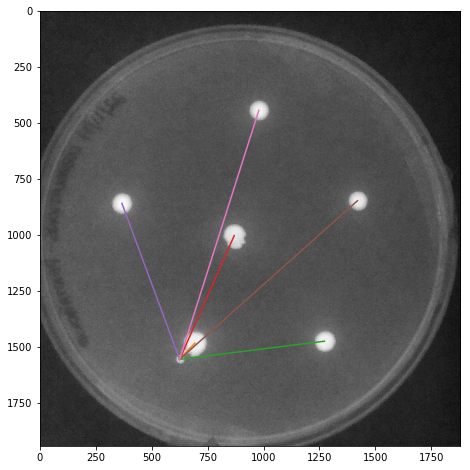

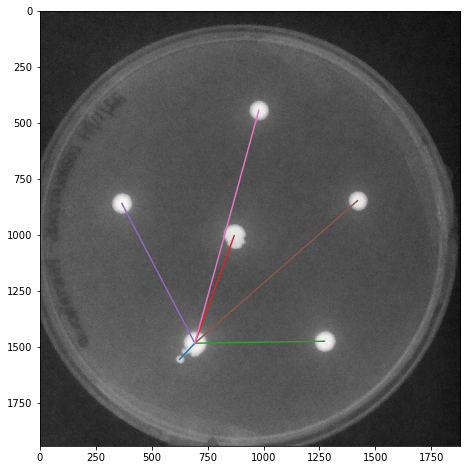

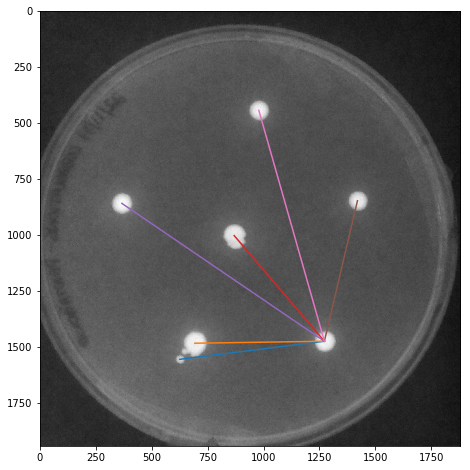

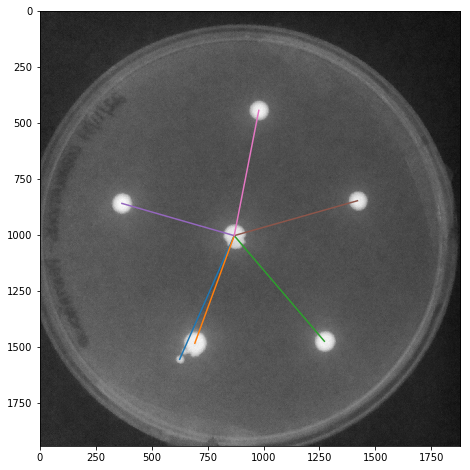

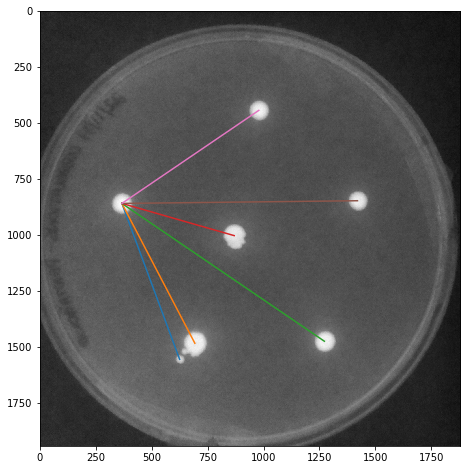

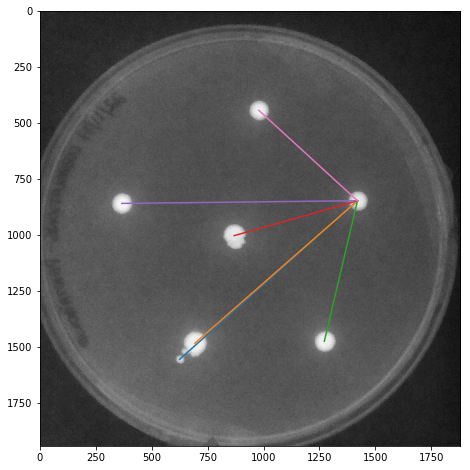

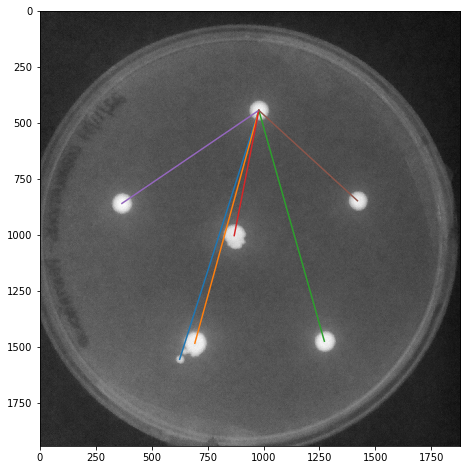

[1167.9404950595729, 1079.5726006156326, 1072.7874906056652, 570.70132293521101, 740.0, 598.07775414238574, 0.0]


In [126]:
def distanceBLOB(blobs,central): #inserta blobD e indice de el blob a investigar (lo ultimo le da flexibilidad para el futuro)
    distcenter = np.sqrt(((blobs[0]-central[0])**2)+((blobs[1]-central[1])**2))
    plt.plot([central[1],blobs[1]],[central[0],blobs[0]])
    return distcenter

for c in range(0, len(A)):
    distcen = []
    plt.figure(figsize=(8,8))
    for element in A:
        distcen.append(distanceBLOB(element,A[c])) #2 por ejemplo
    plt.imshow(ng_image, cmap='gray')
    plt.show()

print(distcen)

In [ ]:
print(radius)
print(distcen)

plt.plot(distcen, radius, "b+")
plt.xlabel("Distancia")
plt.ylabel("Radio colonia")
plt.show()

In [ ]:
def distanceBLOB(blobs,central): #inserta blobD e indice de el blob a investigar (lo ultimo le da flexibilidad para el futuro)
    distcenter = np.sqrt(((blobs[0]-central[0])**2)+((blobs[1]-central[1])**2))
    
    plt.plot([central[1],blobs[1]],[central[0],blobs[0]])
    return distcenter

#IMPORTANTE, ESTE CODIGO NO CONSIDERARA CADA UNA DE NUESTRAS IMAGENES COMO DISTINTAS, NUESTRO RADIO ES DISTINTO PARA
#CADA IMAGEN, NUESTRAS DISTANCIAS SON "DISTINTAS" PARA CADA IMAGEN Y ESO ES LO QUE CORRELACIONAMOS PARA CADA INTENTO
#DEL EXPERIMENTO, POR LO CUAL FLUOPI, QUE USA TIMELAPSES, PARA --LAS MISMAS PLACAS-- NO NOS SIRVE.

distrad = []
distcen = []
#radius = r_fit
plt.figure(figsize=(8,8))
i = 0

avdist = 0
avrad = 0

#(y,x,sigma)
print(A) 

for element in A:
    i += 1
    if i >= len(A):
        continue
    central = 0 #por ejemplo
    distances = distanceBLOB(element,A[central])
    distrad.append([distances,radius[i], radius[central],len(A)]) #distrad es [distancia,radiosatelite,radiocentral,numerodeblobs] 
    avdist += distances/len(A)
    avrad +=radius[central]/len(A)

    
'''
for element in distrad:
    xi,xp = element[2],avdrad
    yi,yp = element[0],avdist
    aux1 += (xi-xp)*(yi-yp)
    aux2 += np.sqrt((xi-xp)**2))
    aux3 += np.sqrt((yi-yp)**2)
    
correlation = aux1/(aux2*aux3)
'''
#aca tenemos una correlacion para 1 n, luego lo hacemos para multiples n y graficamos n versus correlacion, encon-
#trando como varia el crecimiento de las baterias dependiendo del numero de bacterias satelites
#Ademas si la curva es bonita, podemos modelarle una curva y asi predecir para cualquier n y aplicarlo a cualquier
#muestra y cualquier colonia centrar.

plt.imshow(ng_image, cmap='gray')
plt.show()
print(distcen)

In [ ]:
# This is C(r)
#C = np.mean(count, 0)
print(C)
#np.savetxt('Cr_Imagen_%s.csv' %arname, C, fmt='%f', delimiter=",")

In [ ]:
#fig2 = plt.figure()
#plt.plot(np.log(R), np.log(C))
#plt.xlabel('Logarithm of Radius (log(R))')
#plt.ylabel('Logarithm of Correlation Function (log(C))')
#plt.title('Log (C) vs Log (R)')
#plt.savefig('Gráfico_2_%s.png' %arname)
#plt.show()

In [ ]:
#from scipy.stats import linregress
#pendiente = linregress(np.log(R[1:N]), np.log(C[1:N]))
#with open('Pendiente_Imagen_%s.txt' %arname, 'a') as g:
#    print(pendiente, file=g)

/Users/jorgeriverosvergara/Desktop/Universidad/10ºSemestre/Biologia Sintetica y Prototipado de Funciones Artificiales/Proyecto/biosync/Drops/All/LBKAN_1G_0.jpg
LBKAN_1G_0.jpg
[42.426406871192853]
[0.0]
[42.426406871192853]
[0.0]


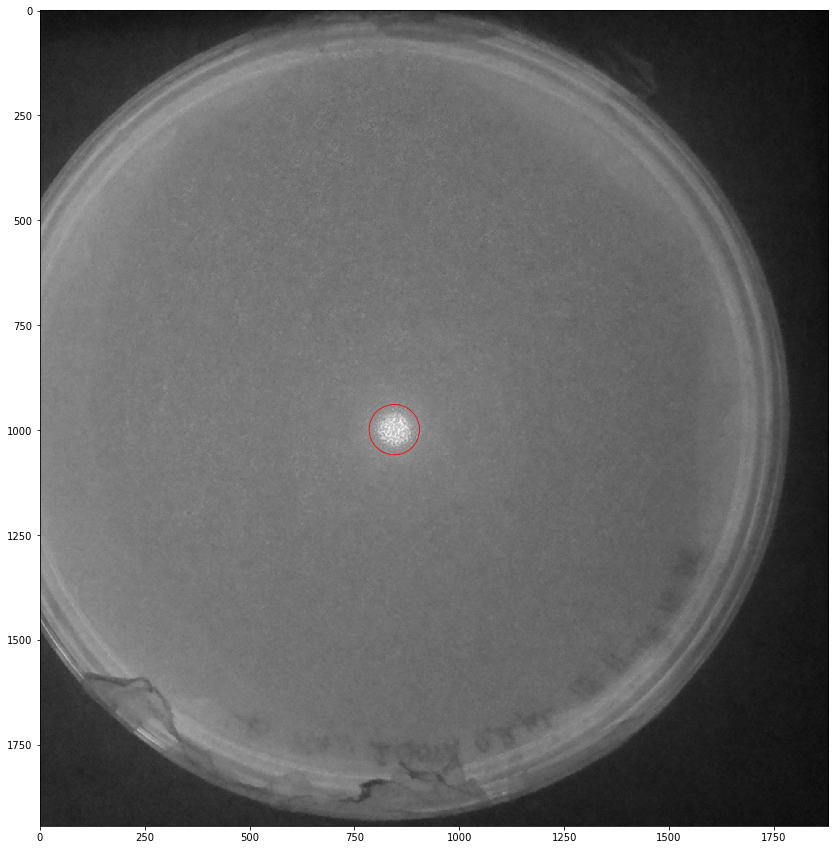

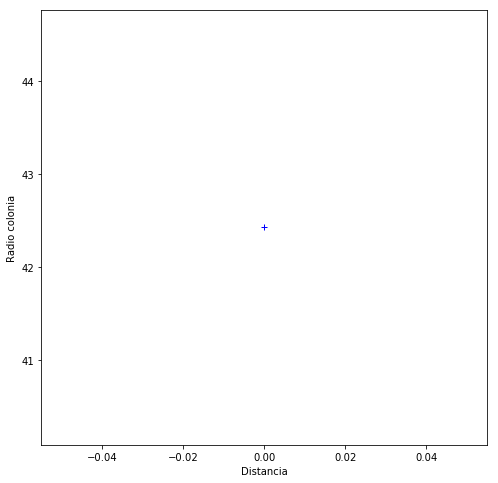

[[ 999.  845.   30.]]


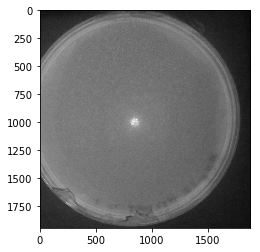

[]
/Users/jorgeriverosvergara/Desktop/Universidad/10ºSemestre/Biologia Sintetica y Prototipado de Funciones Artificiales/Proyecto/biosync/Drops/All/LBKAN_1G_1.jpg
LBKAN_1G_1.jpg
[35.355339059327378]
[0.0]
[35.355339059327378]
[0.0]


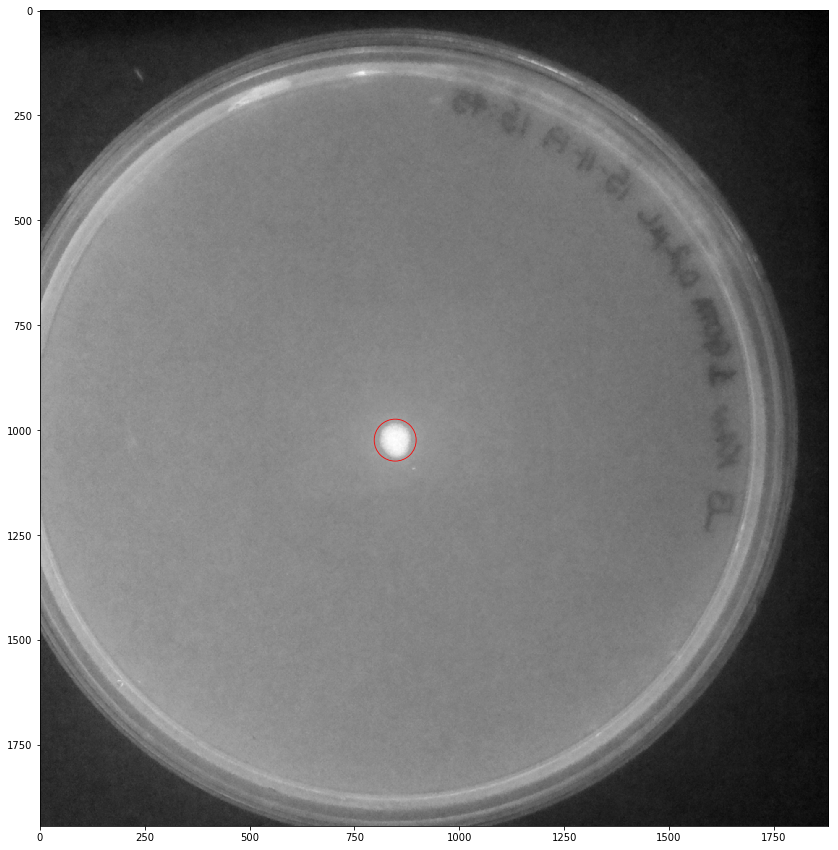

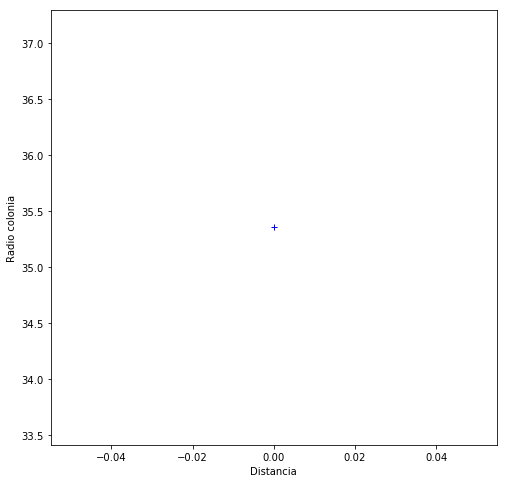

[[ 1024.   847.    25.]]


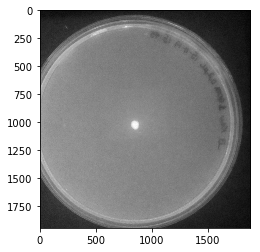

[]
/Users/jorgeriverosvergara/Desktop/Universidad/10ºSemestre/Biologia Sintetica y Prototipado de Funciones Artificiales/Proyecto/biosync/Drops/All/LBKAN_1G_2.jpg
LBKAN_1G_2.jpg
[35.355339059327378]
[0.0]
[35.355339059327378]
[0.0]


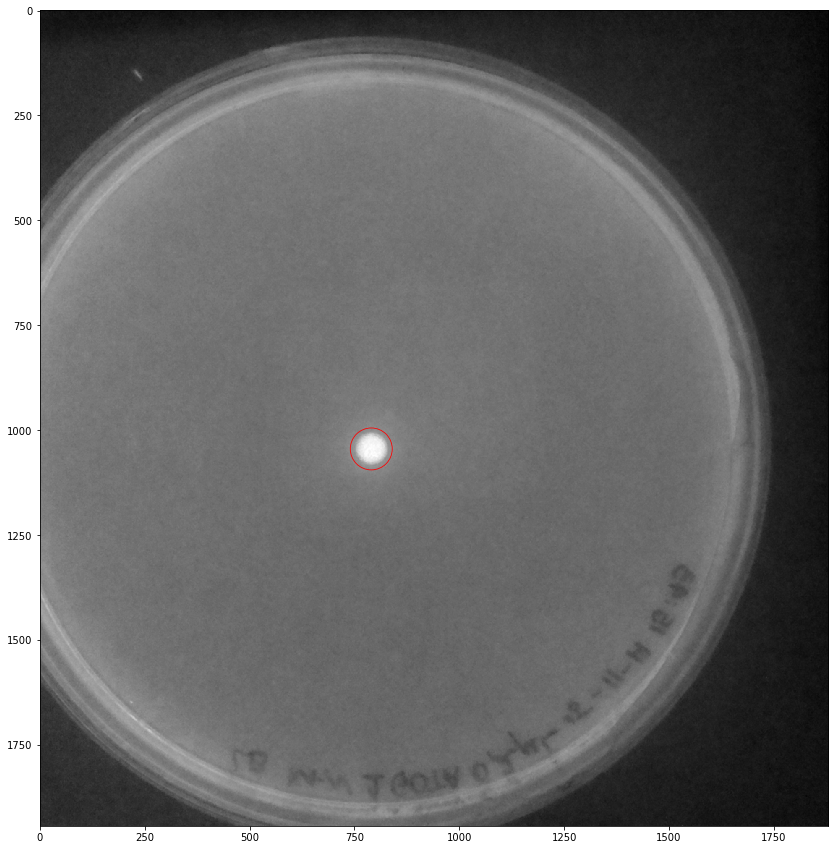

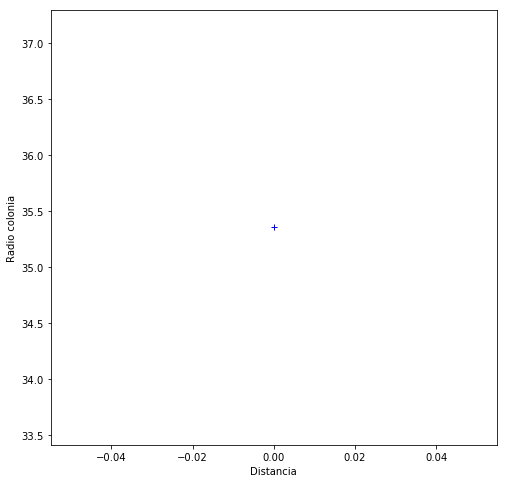

[[ 1045.   790.    25.]]


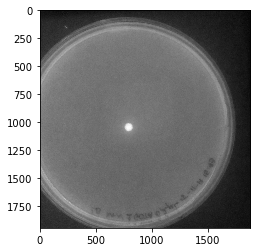

[]
/Users/jorgeriverosvergara/Desktop/Universidad/10ºSemestre/Biologia Sintetica y Prototipado de Funciones Artificiales/Proyecto/biosync/Drops/All/LBKAN_1G_3.jpg
LBKAN_1G_3.jpg
[35.355339059327378]
[0.0]
[35.355339059327378]
[0.0]


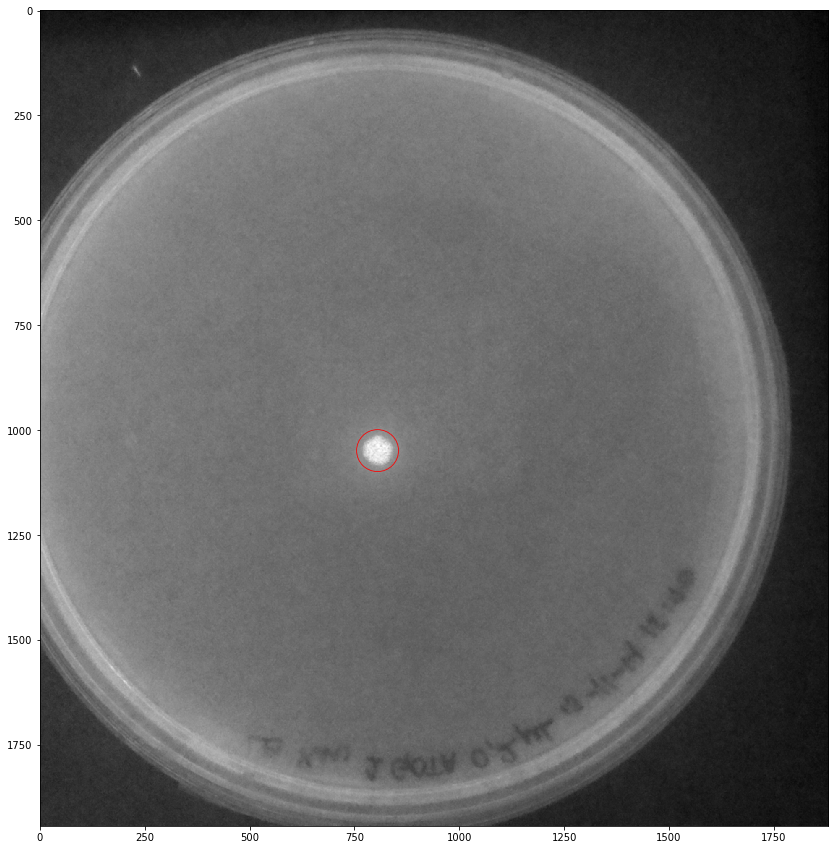

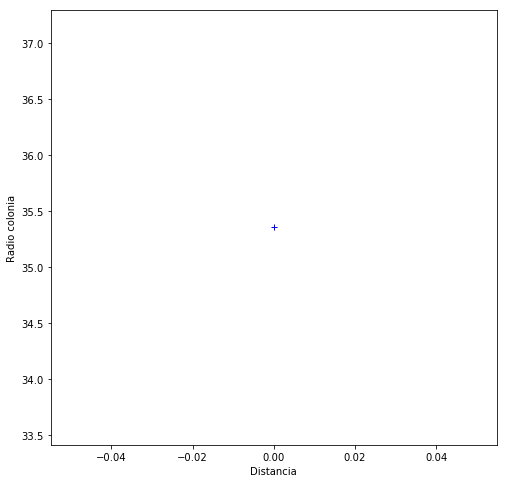

[[ 1049.   805.    25.]]


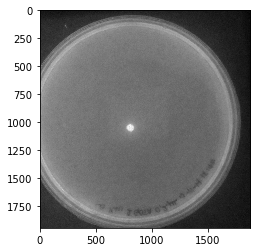

[]
/Users/jorgeriverosvergara/Desktop/Universidad/10ºSemestre/Biologia Sintetica y Prototipado de Funciones Artificiales/Proyecto/biosync/Drops/All/LBKAN_1G_4.jpg
LBKAN_1G_4.jpg
[28.284271247461902]
[0.0]
[28.284271247461902]
[0.0]


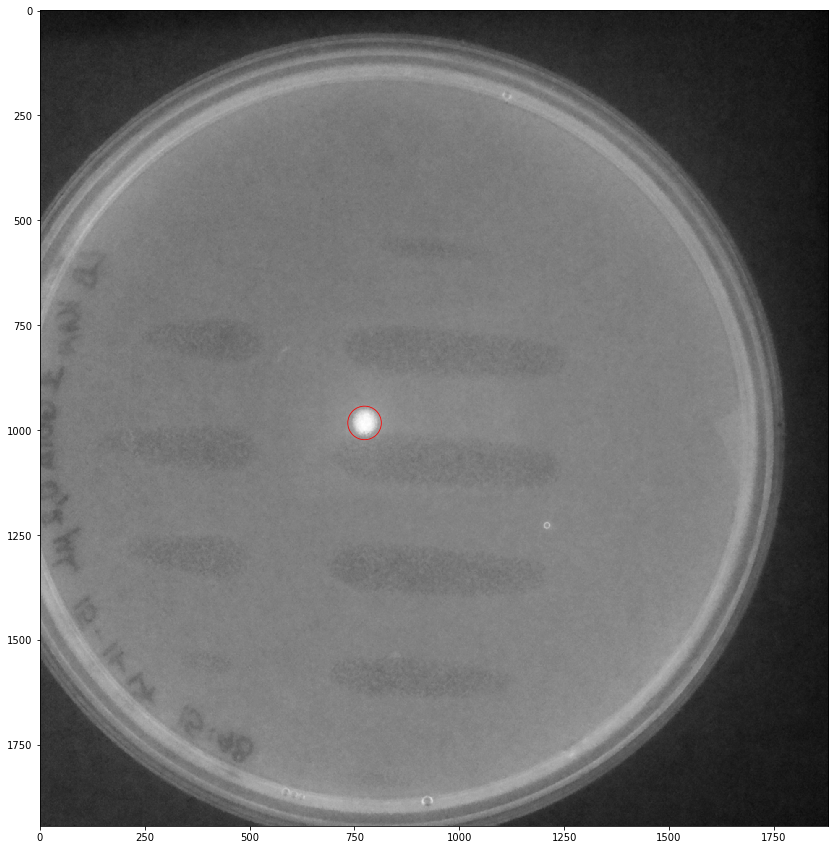

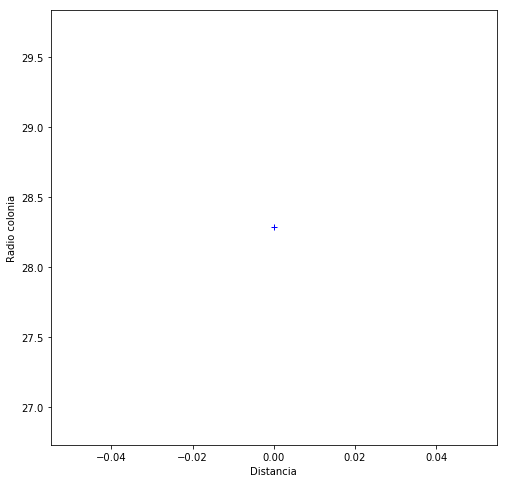

[[ 983.  774.   20.]]


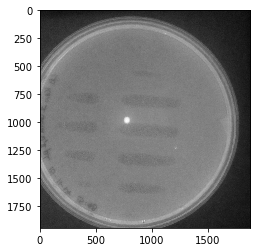

[]
/Users/jorgeriverosvergara/Desktop/Universidad/10ºSemestre/Biologia Sintetica y Prototipado de Funciones Artificiales/Proyecto/biosync/Drops/All/LBKAN_1G_5.jpg
LBKAN_1G_5.jpg
[21.213203435596427, 21.213203435596427, 49.497474683058329]
[369.08671067921154, 224.1428116179504, 0.0]
[21.213203435596427, 21.213203435596427, 49.497474683058329]
[369.08671067921154, 224.1428116179504, 0.0]


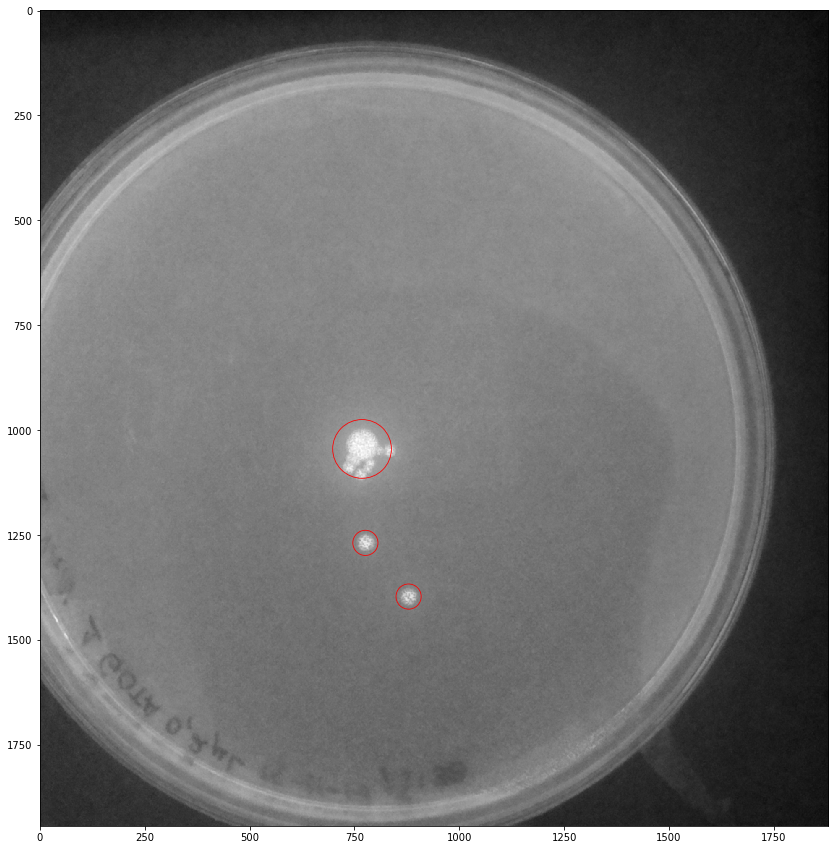

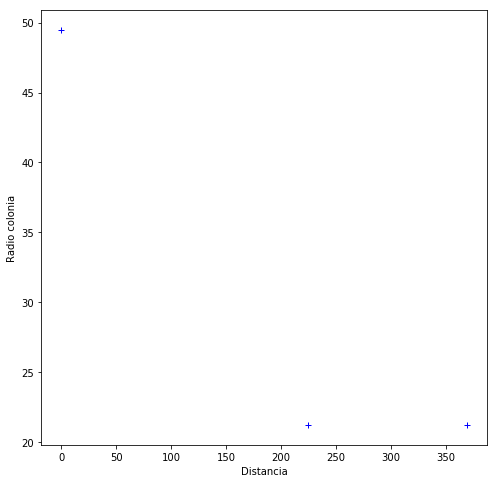

[[ 1397.   879.    15.]
 [ 1269.   776.    15.]
 [ 1045.   768.    35.]]


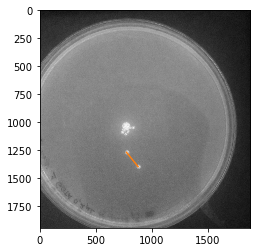

[]
/Users/jorgeriverosvergara/Desktop/Universidad/10ºSemestre/Biologia Sintetica y Prototipado de Funciones Artificiales/Proyecto/biosync/Drops/All/LBKAN_2G_0.jpg
LBKAN_2G_0.jpg
[35.355339059327378, 35.355339059327378]
[624.47417880966066, 0.0]
[35.355339059327378, 35.355339059327378]
[624.47417880966066, 0.0]


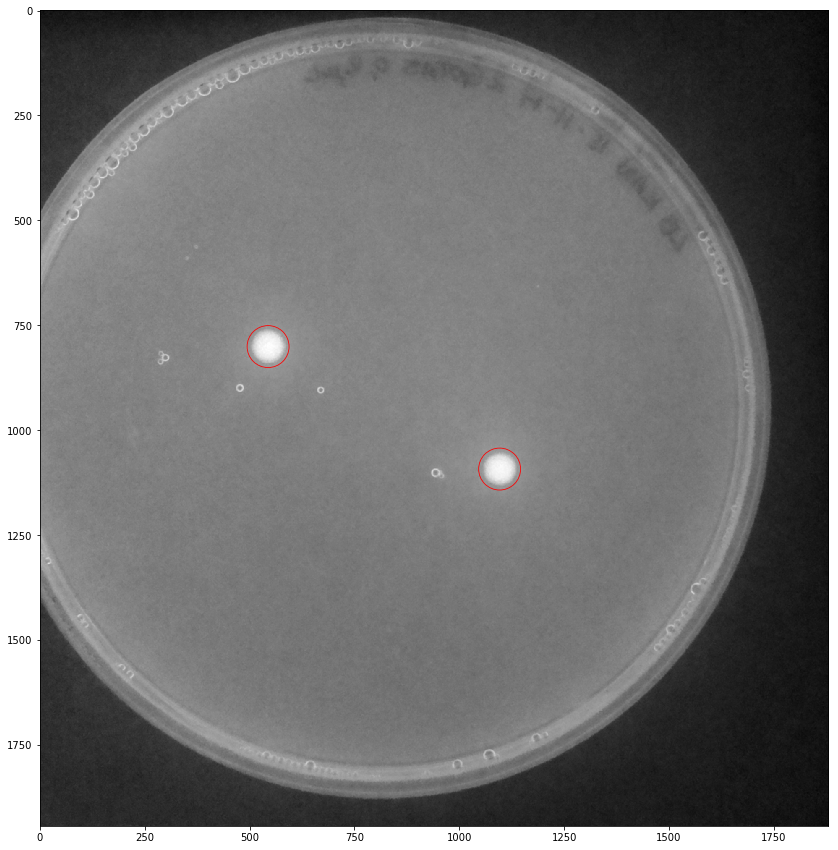

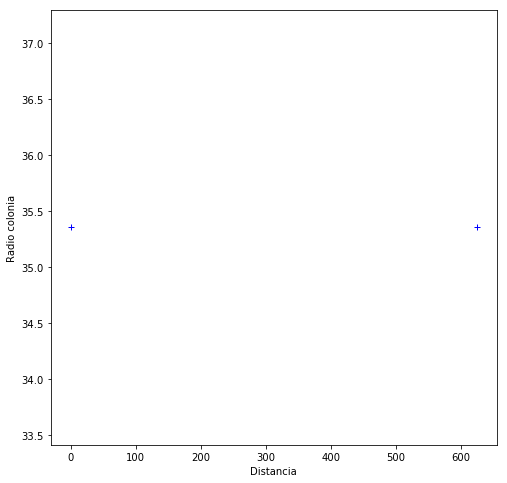

[[ 1093.  1096.    25.]
 [  801.   544.    25.]]


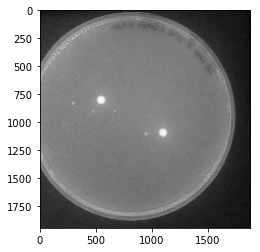

[]
/Users/jorgeriverosvergara/Desktop/Universidad/10ºSemestre/Biologia Sintetica y Prototipado de Funciones Artificiales/Proyecto/biosync/Drops/All/LBKAN_2G_1.jpg
LBKAN_2G_1.jpg
[35.355339059327378, 35.355339059327378]
[617.65443412963532, 0.0]
[35.355339059327378, 35.355339059327378]
[617.65443412963532, 0.0]


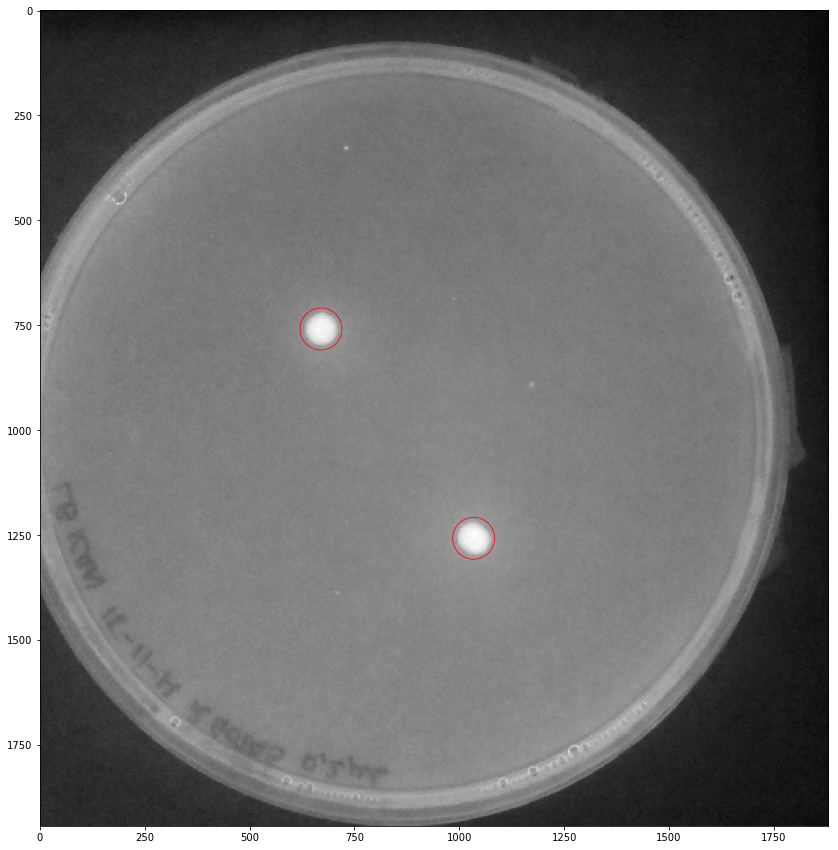

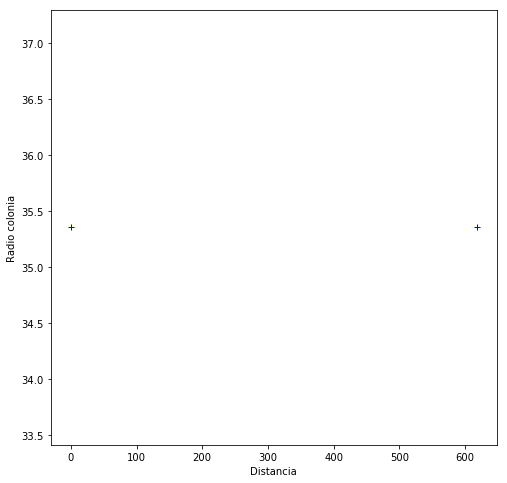

[[ 1258.  1034.    25.]
 [  759.   670.    25.]]


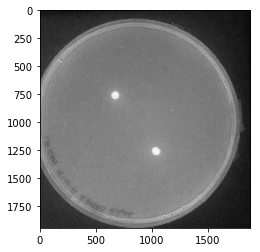

[]
/Users/jorgeriverosvergara/Desktop/Universidad/10ºSemestre/Biologia Sintetica y Prototipado de Funciones Artificiales/Proyecto/biosync/Drops/All/LBKAN_2G_2.jpg
LBKAN_2G_2.jpg
[42.426406871192853, 35.355339059327378]
[622.9133166019169, 0.0]
[42.426406871192853, 35.355339059327378]
[622.9133166019169, 0.0]


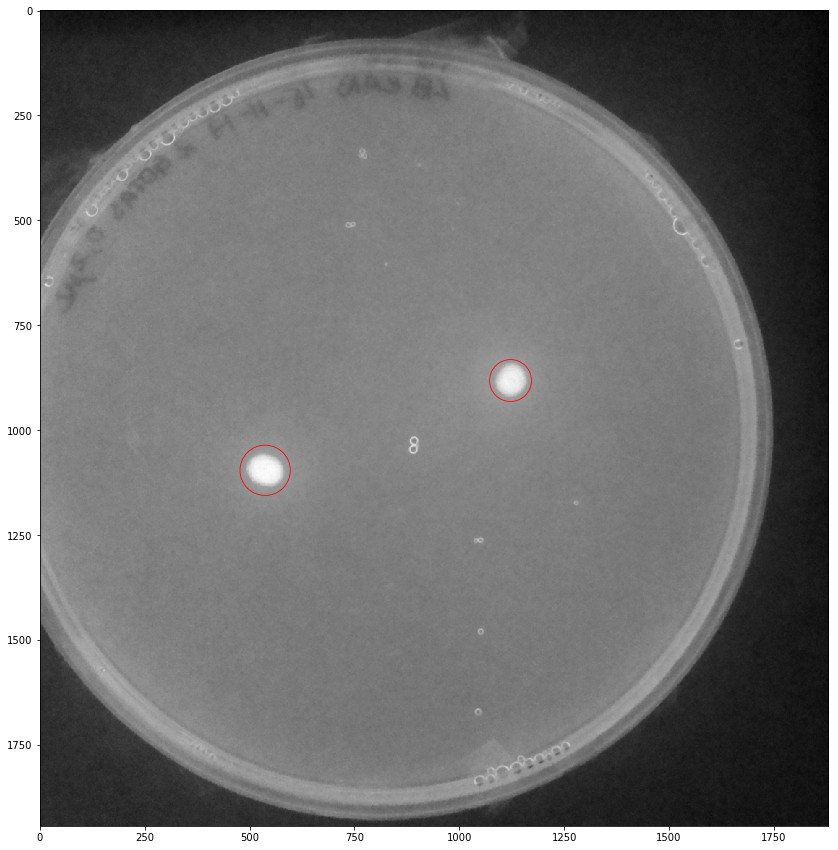

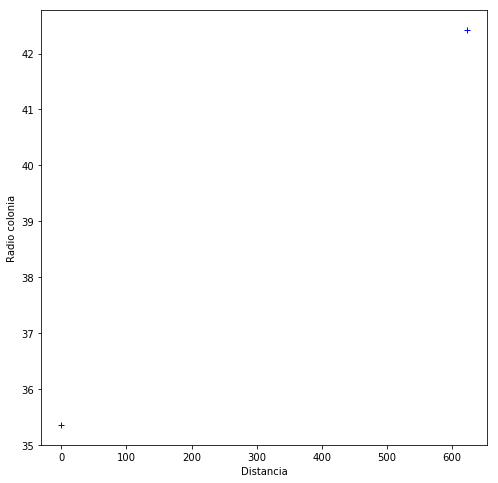

[[ 1096.   537.    30.]
 [  882.  1122.    25.]]


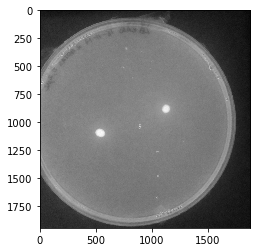

[]
/Users/jorgeriverosvergara/Desktop/Universidad/10ºSemestre/Biologia Sintetica y Prototipado de Funciones Artificiales/Proyecto/biosync/Drops/All/LBKAN_2G_3.jpg
LBKAN_2G_3.jpg
[35.355339059327378, 35.355339059327378]
[612.69405089326597, 0.0]
[35.355339059327378, 35.355339059327378]
[612.69405089326597, 0.0]


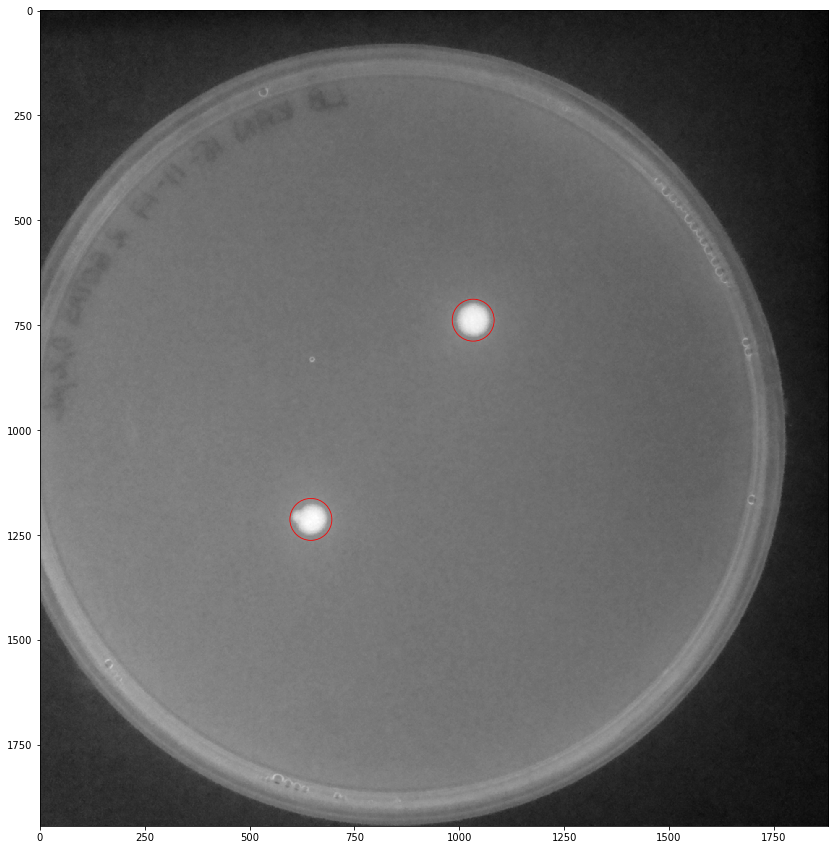

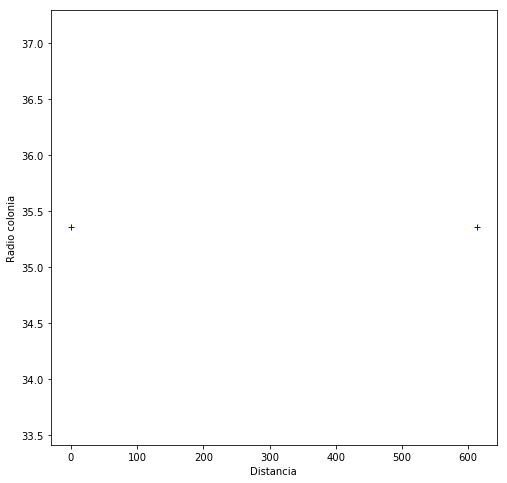

[[ 1213.   646.    25.]
 [  738.  1033.    25.]]


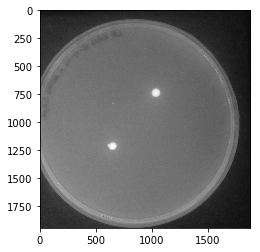

[]
/Users/jorgeriverosvergara/Desktop/Universidad/10ºSemestre/Biologia Sintetica y Prototipado de Funciones Artificiales/Proyecto/biosync/Drops/All/LBKAN_2G_4.jpg
LBKAN_2G_4.jpg
[35.355339059327378, 35.355339059327378]
[617.40424358761902, 0.0]
[35.355339059327378, 35.355339059327378]
[617.40424358761902, 0.0]


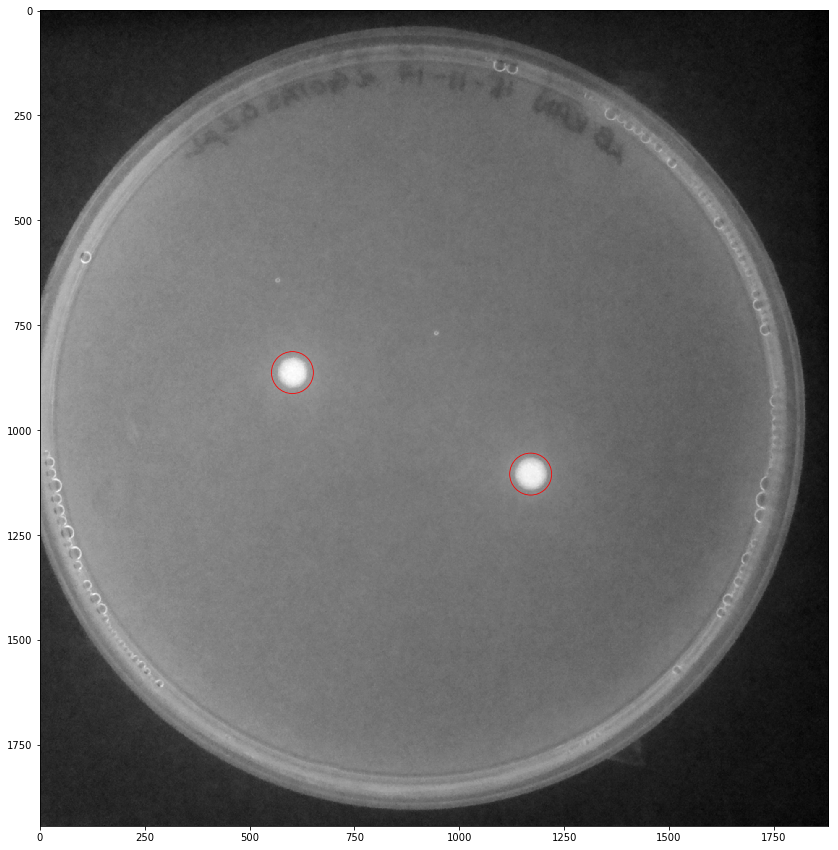

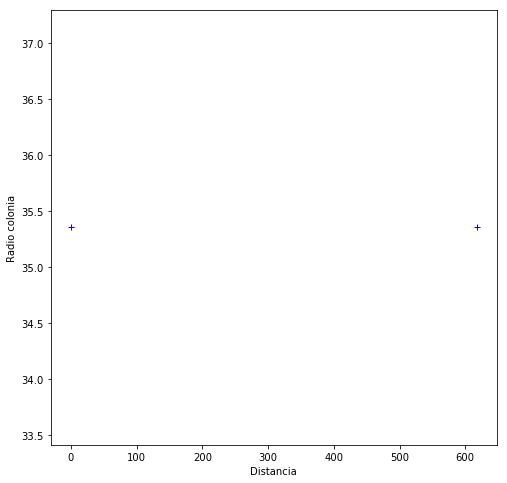

[[ 1105.  1170.    25.]
 [  863.   602.    25.]]


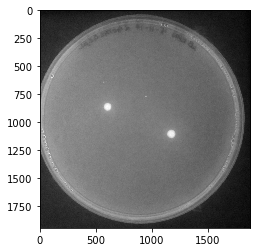

[]
/Users/jorgeriverosvergara/Desktop/Universidad/10ºSemestre/Biologia Sintetica y Prototipado de Funciones Artificiales/Proyecto/biosync/Drops/All/LBKAN_2G_5.jpg
LBKAN_2G_5.jpg
[42.426406871192853, 35.355339059327378]
[635.05039170132, 0.0]
[42.426406871192853, 35.355339059327378]
[635.05039170132, 0.0]


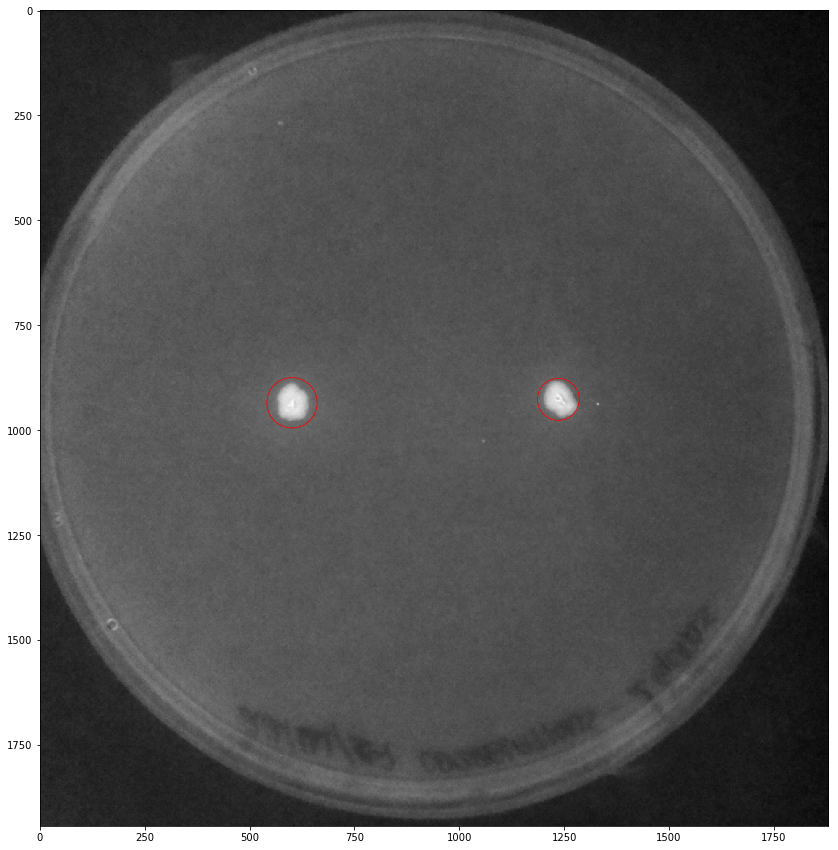

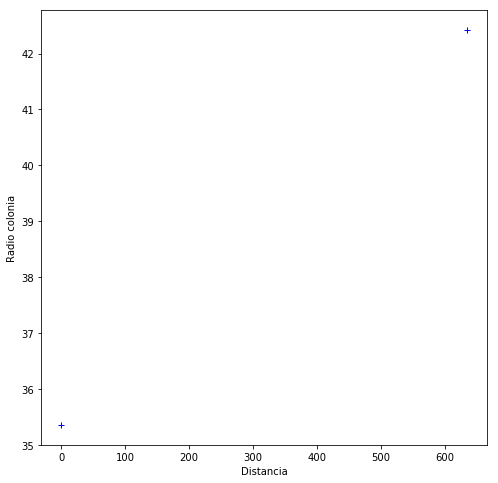

[[  935.   601.    30.]
 [  927.  1236.    25.]]


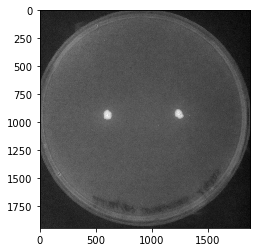

[]
/Users/jorgeriverosvergara/Desktop/Universidad/10ºSemestre/Biologia Sintetica y Prototipado de Funciones Artificiales/Proyecto/biosync/Drops/All/LBKAN_2G_6.jpg
LBKAN_2G_6.jpg
[35.355339059327378, 28.284271247461902]
[634.2633522441605, 0.0]
[35.355339059327378, 28.284271247461902]
[634.2633522441605, 0.0]


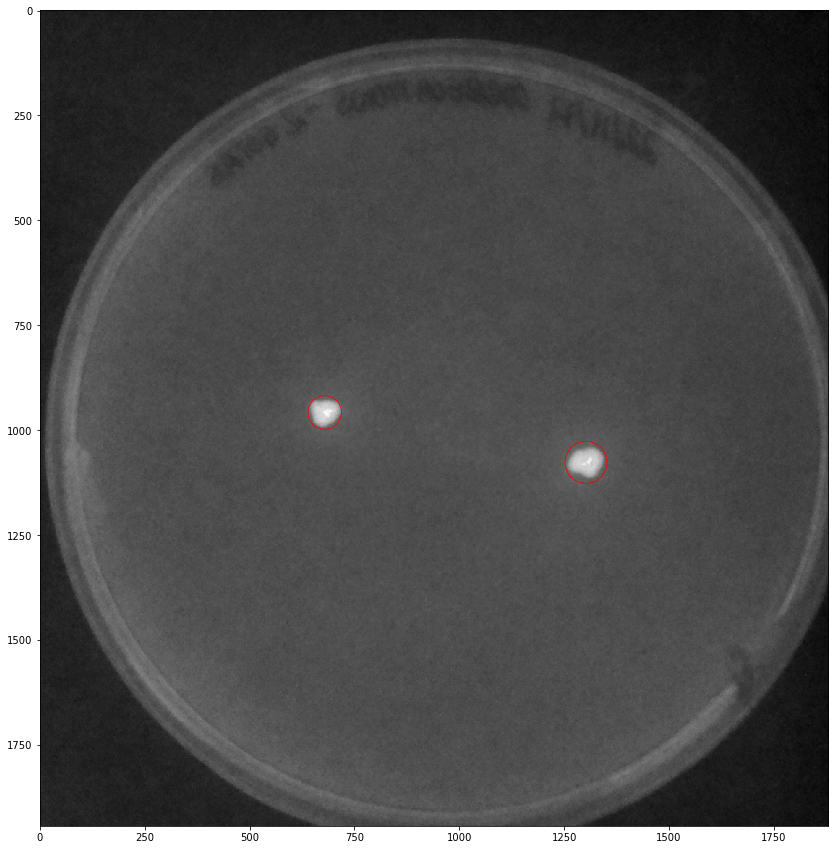

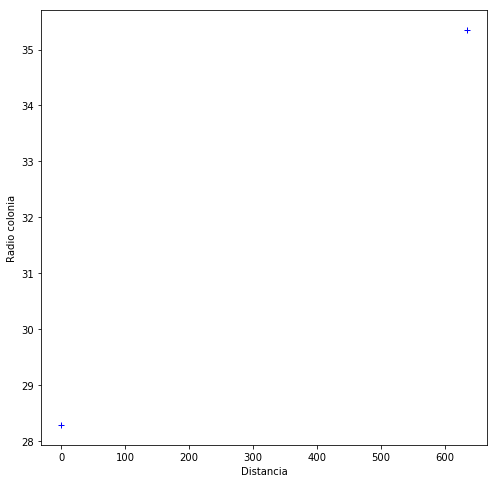

[[ 1077.  1302.    25.]
 [  958.   679.    20.]]


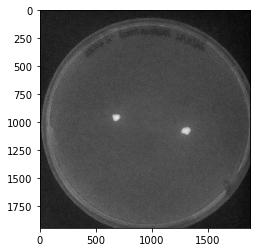

[]
/Users/jorgeriverosvergara/Desktop/Universidad/10ºSemestre/Biologia Sintetica y Prototipado de Funciones Artificiales/Proyecto/biosync/Drops/All/LBKAN_3G_0.jpg
LBKAN_3G_0.jpg
[35.355339059327378, 35.355339059327378, 42.426406871192853]
[617.73780845921999, 767.27570012349543, 0.0]
[35.355339059327378, 35.355339059327378, 42.426406871192853]
[617.73780845921999, 767.27570012349543, 0.0]


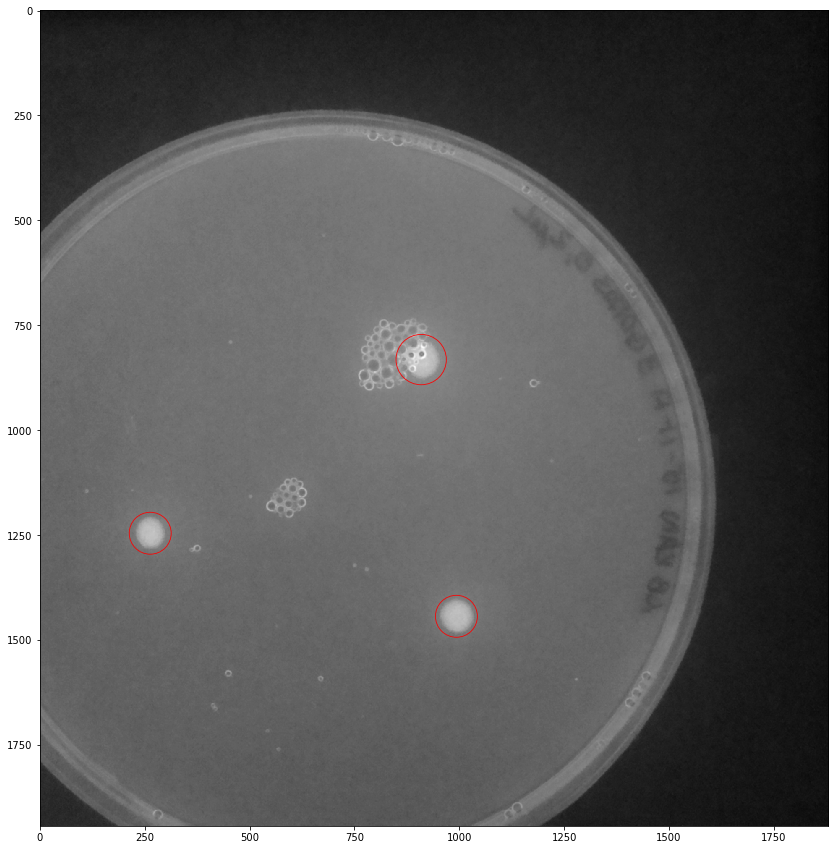

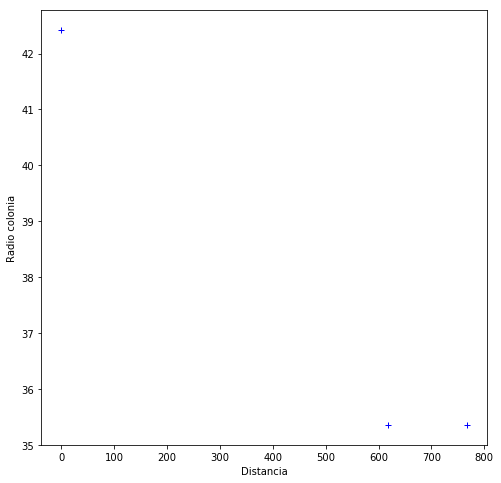

[[ 1444.   993.    25.]
 [ 1246.   263.    25.]
 [  832.   909.    30.]]


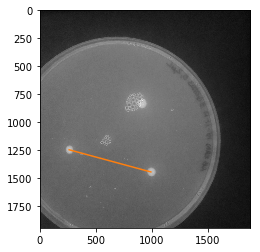

[]
/Users/jorgeriverosvergara/Desktop/Universidad/10ºSemestre/Biologia Sintetica y Prototipado de Funciones Artificiales/Proyecto/biosync/Drops/All/LBKAN_3G_1.jpg
LBKAN_3G_1.jpg
[35.355339059327378, 35.355339059327378, 14.142135623730951, 14.142135623730951, 35.355339059327378]
[733.34643927682635, 765.0993399552766, 616.29213851873851, 530.74381767477985, 0.0]
[35.355339059327378, 35.355339059327378, 14.142135623730951, 14.142135623730951, 35.355339059327378]
[733.34643927682635, 765.0993399552766, 616.29213851873851, 530.74381767477985, 0.0]


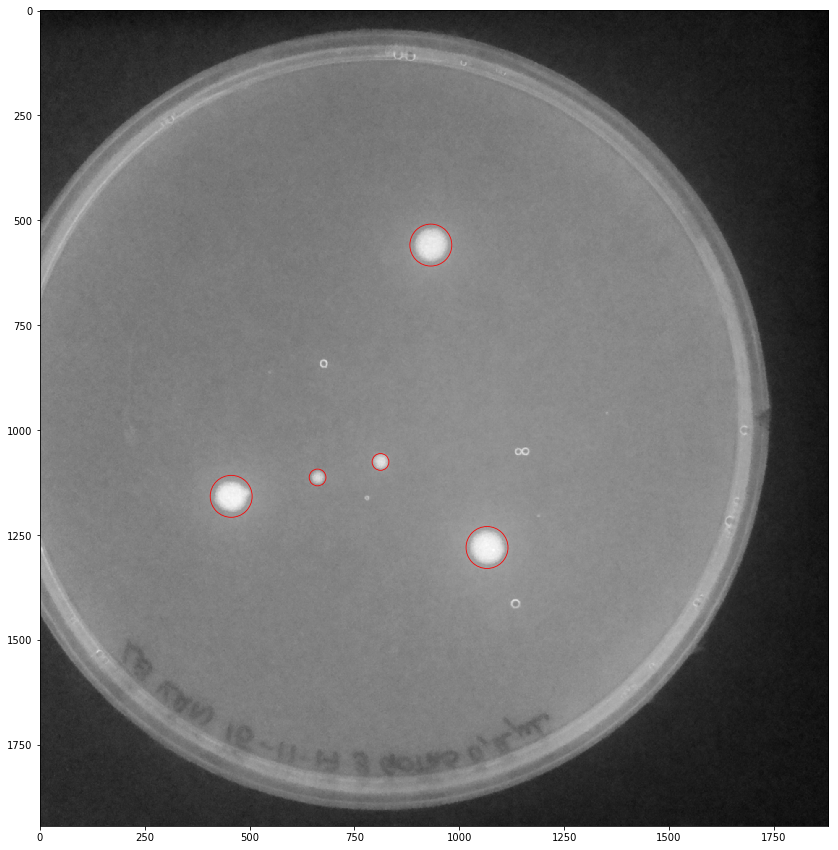

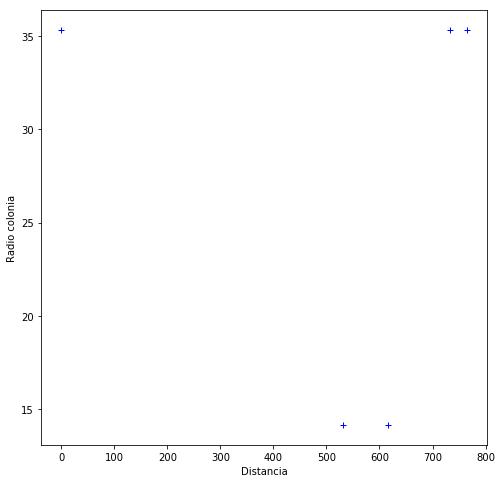

[[ 1280.  1066.    25.]
 [ 1158.   456.    25.]
 [ 1113.   662.    10.]
 [ 1076.   812.    10.]
 [  559.   932.    25.]]


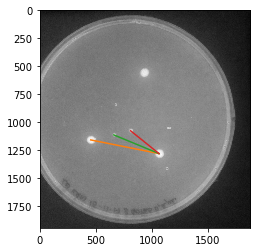

[]
/Users/jorgeriverosvergara/Desktop/Universidad/10ºSemestre/Biologia Sintetica y Prototipado de Funciones Artificiales/Proyecto/biosync/Drops/All/LBKAN_3G_2.jpg
LBKAN_3G_2.jpg
[35.355339059327378, 35.355339059327378, 35.355339059327378]
[734.15529692293308, 775.34250496151697, 0.0]
[35.355339059327378, 35.355339059327378, 35.355339059327378]
[734.15529692293308, 775.34250496151697, 0.0]


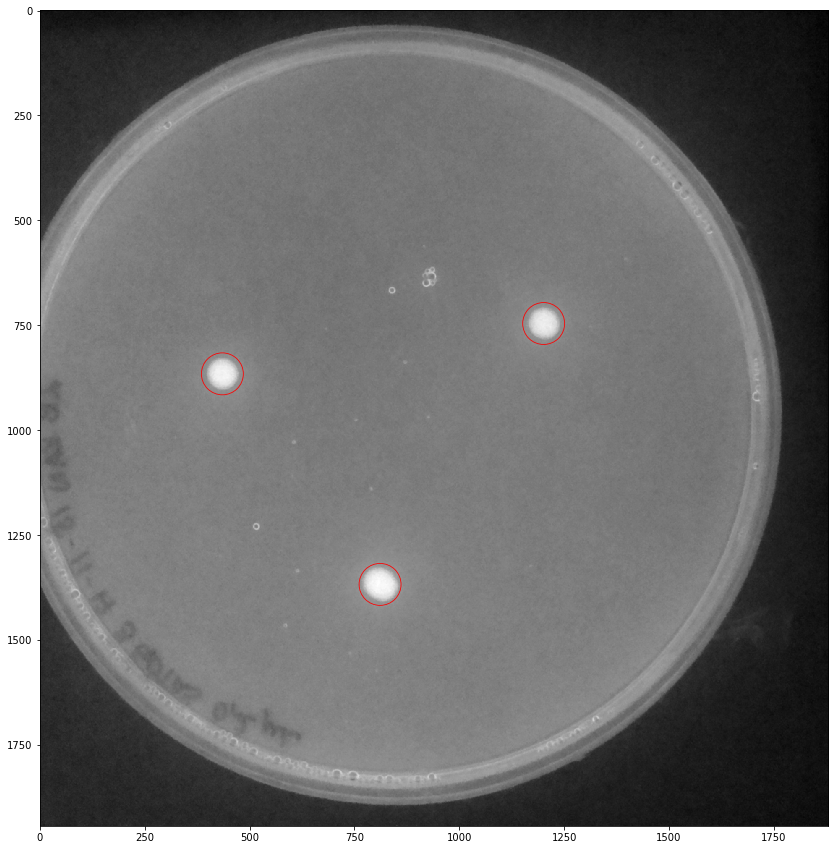

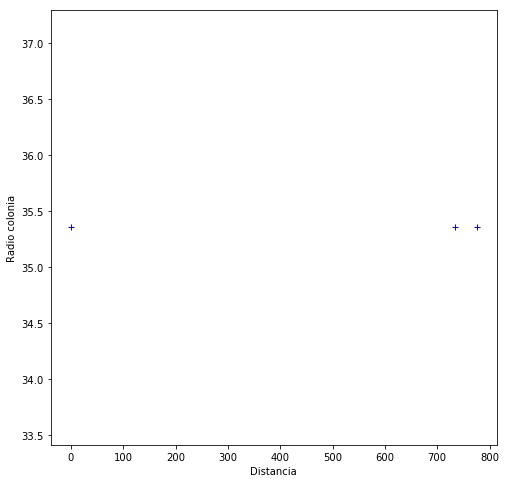

[[ 1368.   811.    25.]
 [  866.   435.    25.]
 [  746.  1201.    25.]]


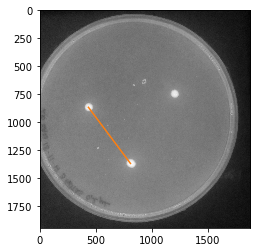

[]
/Users/jorgeriverosvergara/Desktop/Universidad/10ºSemestre/Biologia Sintetica y Prototipado de Funciones Artificiales/Proyecto/biosync/Drops/All/LBKAN_3G_3.jpg
LBKAN_3G_3.jpg
[35.355339059327378, 42.426406871192853, 35.355339059327378]
[774.109165428236, 724.10565527414576, 0.0]
[35.355339059327378, 42.426406871192853, 35.355339059327378]
[774.109165428236, 724.10565527414576, 0.0]


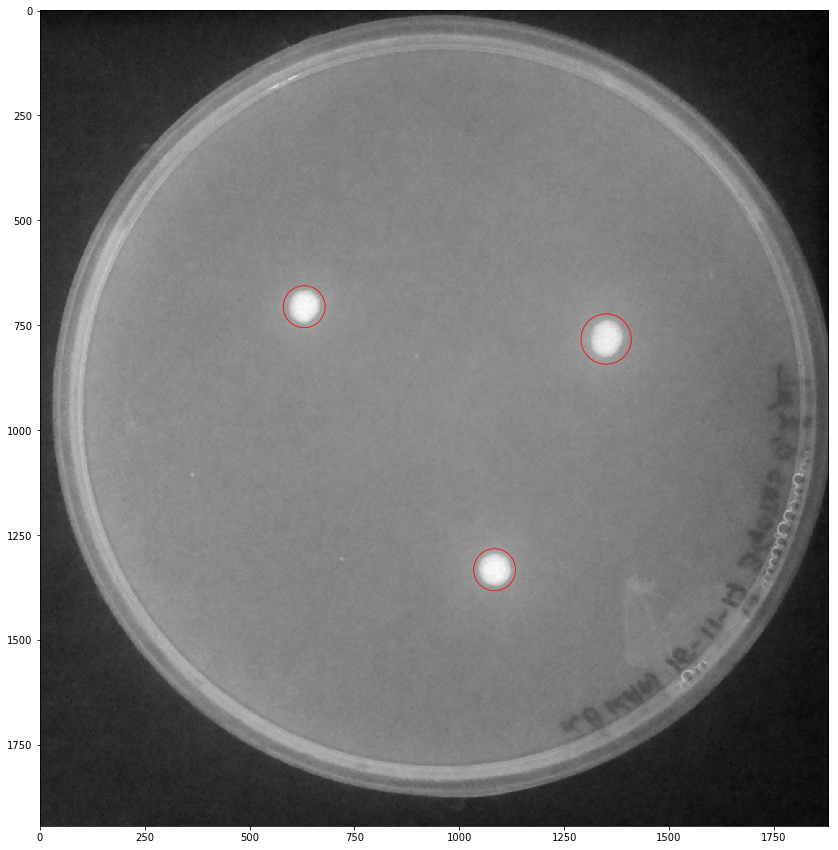

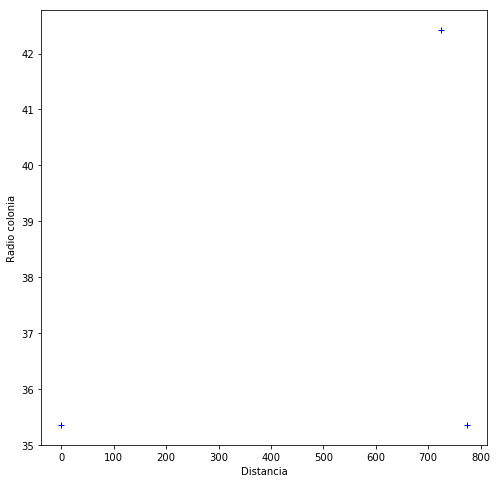

[[ 1333.  1084.    25.]
 [  783.  1350.    30.]
 [  706.   630.    25.]]


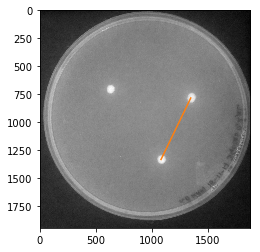

[]
/Users/jorgeriverosvergara/Desktop/Universidad/10ºSemestre/Biologia Sintetica y Prototipado de Funciones Artificiales/Proyecto/biosync/Drops/All/LBKAN_3G_4.jpg
LBKAN_3G_4.jpg
[35.355339059327378, 42.426406871192853, 42.426406871192853]
[755.74863546023028, 732.53805361905938, 0.0]
[35.355339059327378, 42.426406871192853, 42.426406871192853]
[755.74863546023028, 732.53805361905938, 0.0]


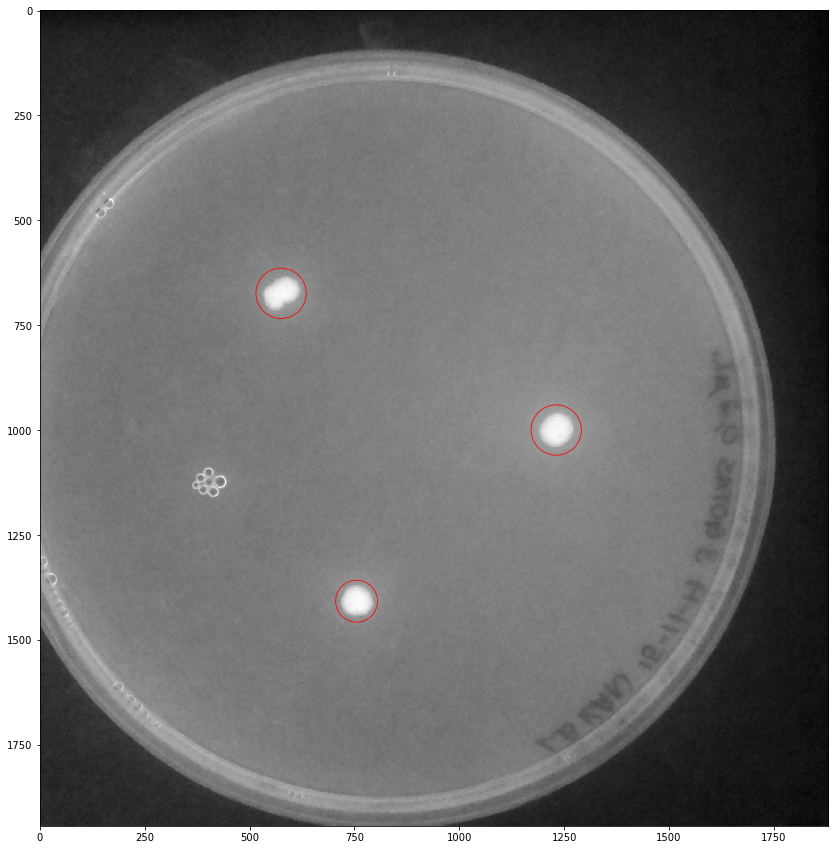

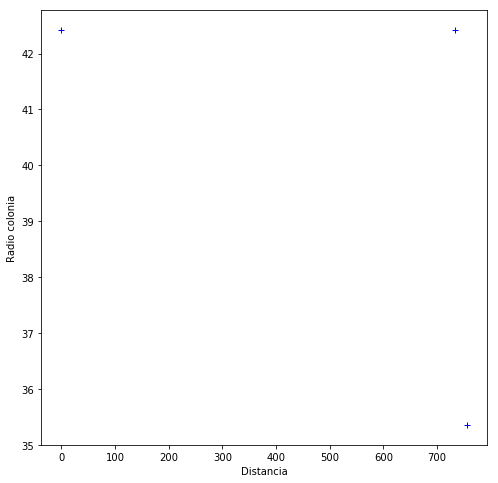

[[ 1408.   755.    25.]
 [ 1000.  1231.    30.]
 [  674.   575.    30.]]


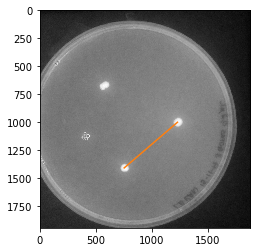

[]
/Users/jorgeriverosvergara/Desktop/Universidad/10ºSemestre/Biologia Sintetica y Prototipado de Funciones Artificiales/Proyecto/biosync/Drops/All/LBKAN_3G_5.jpg
LBKAN_3G_5.jpg
[35.355339059327378, 35.355339059327378, 42.426406871192853]
[753.260247192164, 775.20706911121499, 0.0]
[35.355339059327378, 35.355339059327378, 42.426406871192853]
[753.260247192164, 775.20706911121499, 0.0]


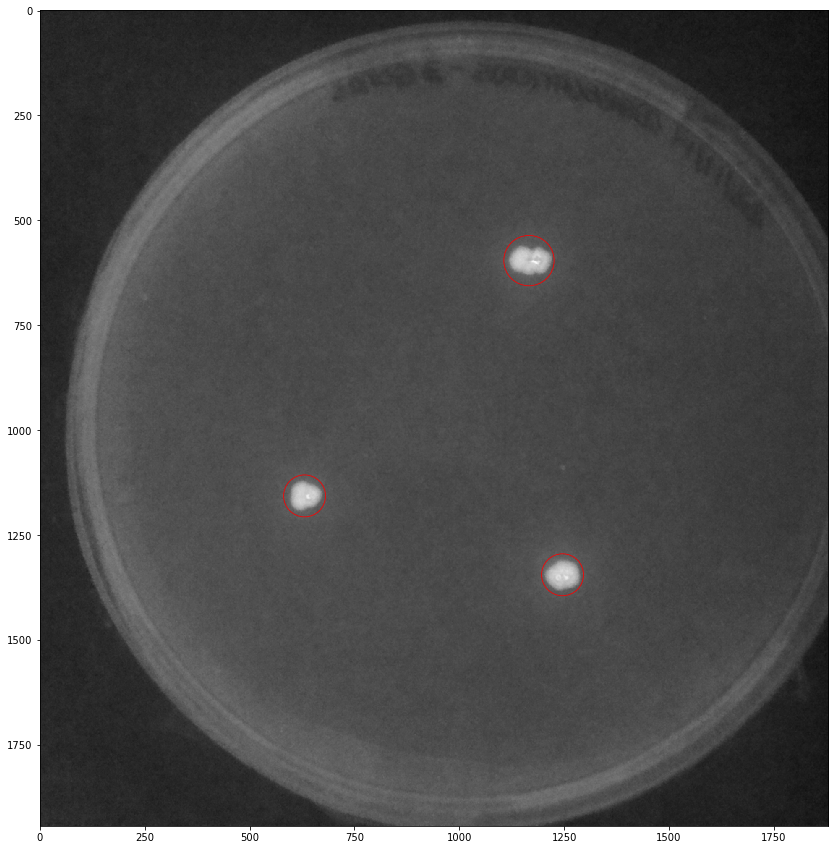

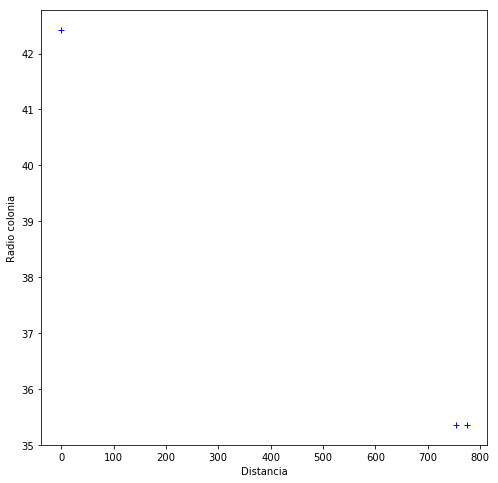

[[ 1345.  1246.    25.]
 [ 1157.   631.    25.]
 [  596.  1166.    30.]]


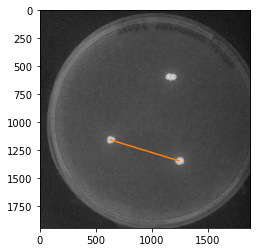

[]
/Users/jorgeriverosvergara/Desktop/Universidad/10ºSemestre/Biologia Sintetica y Prototipado de Funciones Artificiales/Proyecto/biosync/Drops/All/LBKAN_3G_6.jpg
LBKAN_3G_6.jpg
[49.497474683058329, 35.355339059327378, 42.426406871192853]
[764.128915825072, 747.41487809649607, 0.0]
[49.497474683058329, 35.355339059327378, 42.426406871192853]
[764.128915825072, 747.41487809649607, 0.0]


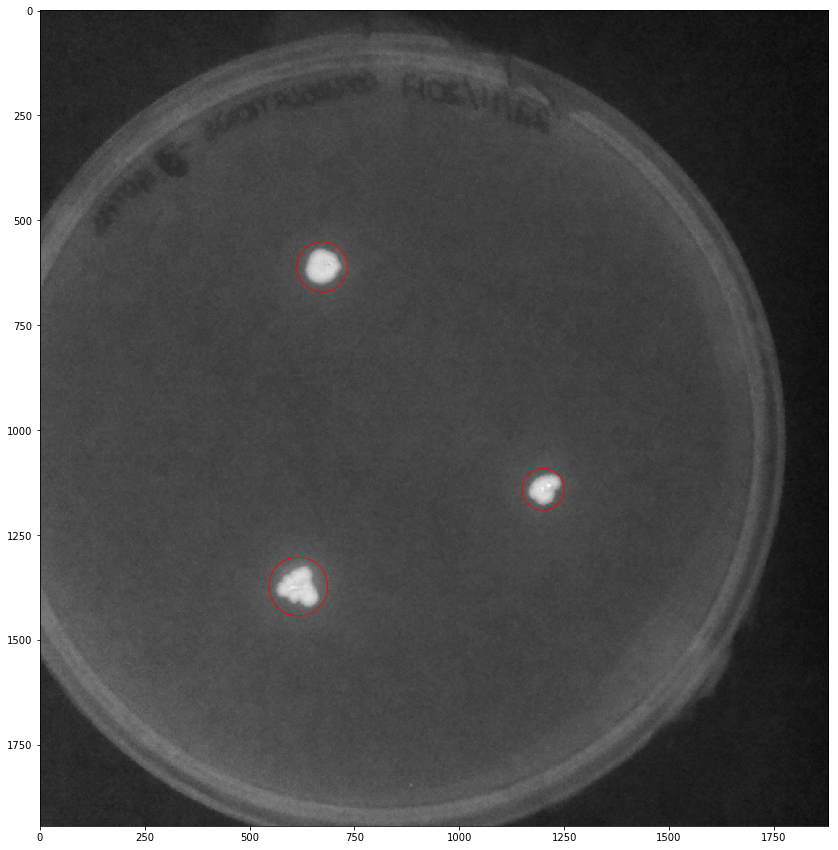

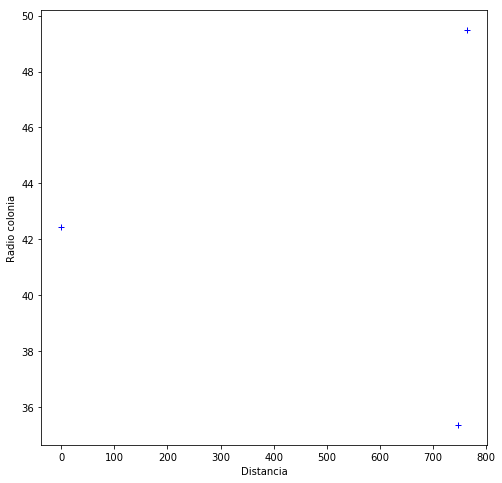

[[ 1373.   616.    35.]
 [ 1141.  1200.    25.]
 [  611.   673.    30.]]


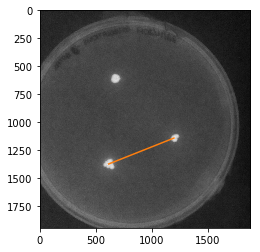

[]
/Users/jorgeriverosvergara/Desktop/Universidad/10ºSemestre/Biologia Sintetica y Prototipado de Funciones Artificiales/Proyecto/biosync/Drops/All/LBKAN_3G_c1.jpg
LBKAN_3G_c1.jpg
[42.426406871192853, 42.426406871192853, 21.213203435596427, 49.497474683058329]
[1066.697707881666, 509.16598472403871, 476.32446924339297, 0.0]
[42.426406871192853, 42.426406871192853, 21.213203435596427, 49.497474683058329]
[1066.697707881666, 509.16598472403871, 476.32446924339297, 0.0]


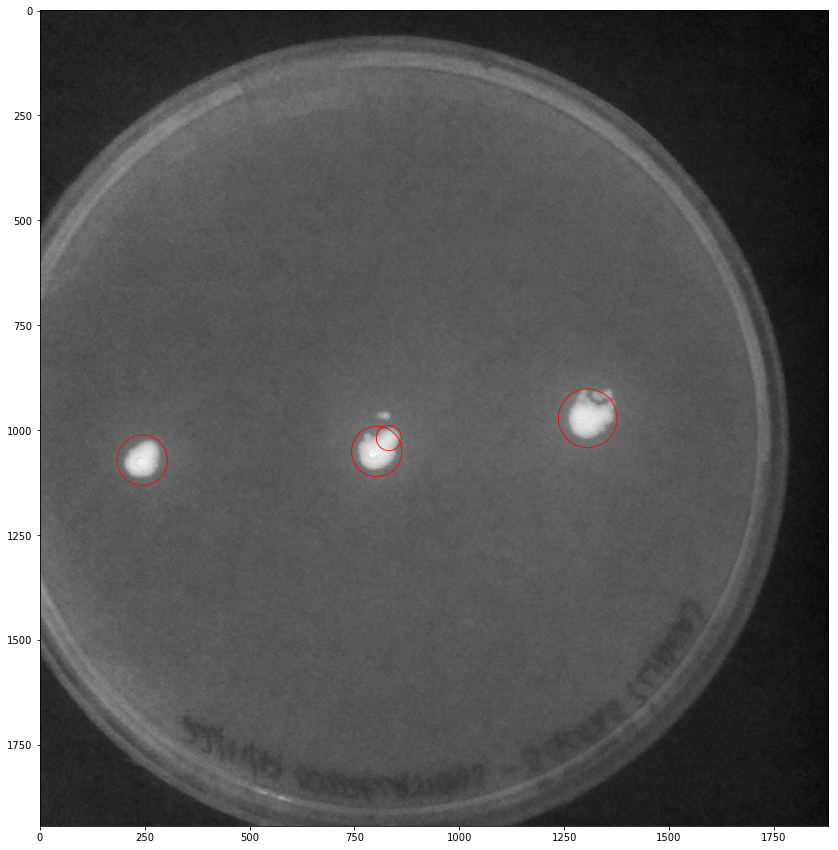

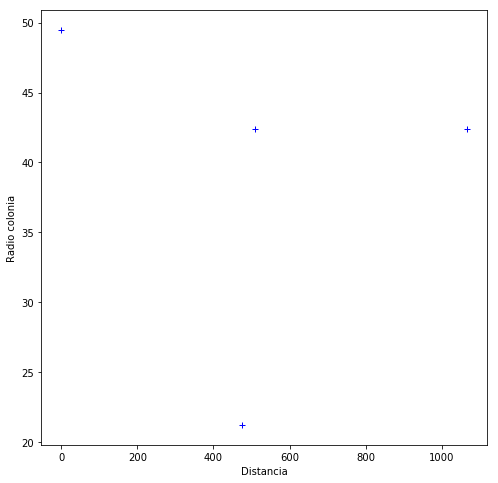

[[ 1072.   244.    30.]
 [ 1051.   803.    30.]
 [ 1019.   832.    15.]
 [  972.  1306.    35.]]


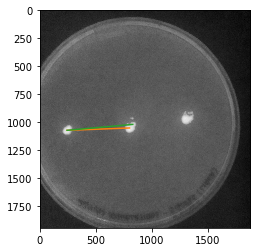

[]
/Users/jorgeriverosvergara/Desktop/Universidad/10ºSemestre/Biologia Sintetica y Prototipado de Funciones Artificiales/Proyecto/biosync/Drops/All/LBKAN_3G_c5.jpg
LBKAN_3G_c5.jpg
[42.426406871192853, 49.497474683058329, 49.497474683058329]
[1060.3758767531444, 491.79670596700828, 0.0]
[42.426406871192853, 49.497474683058329, 49.497474683058329]
[1060.3758767531444, 491.79670596700828, 0.0]


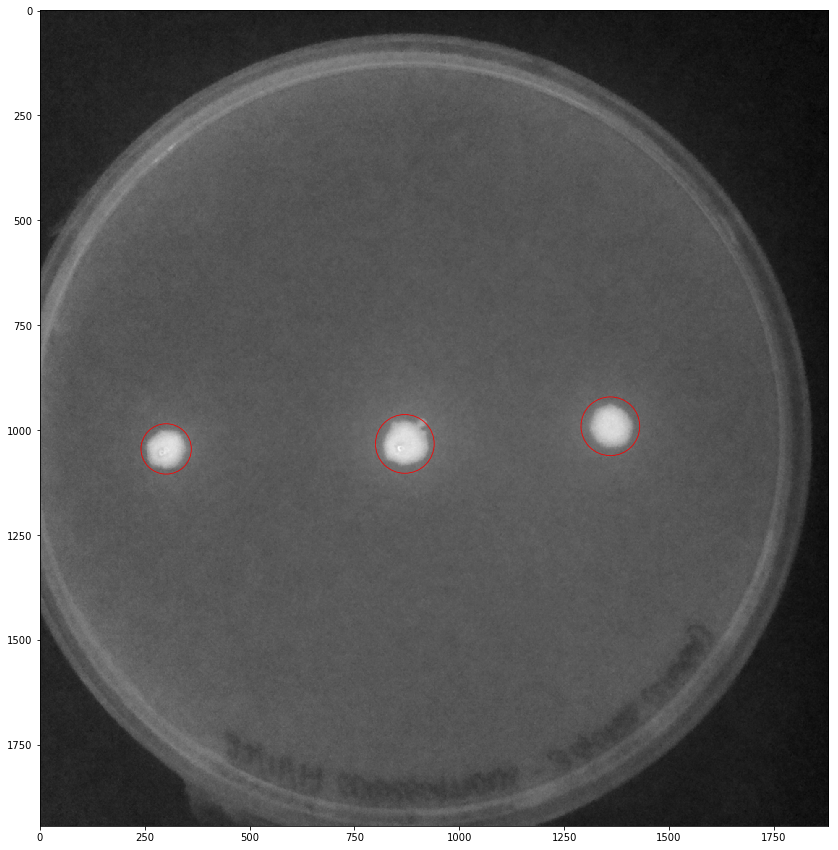

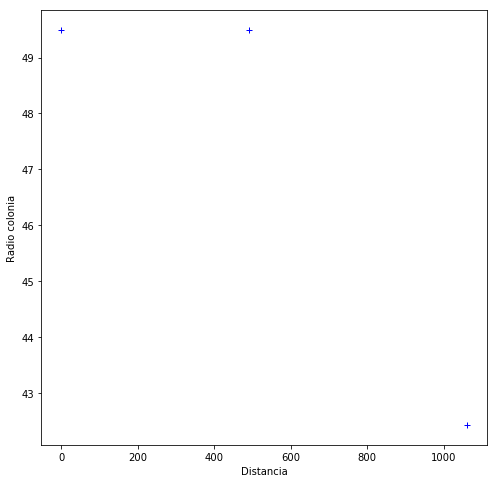

[[ 1045.   301.    30.]
 [ 1033.   870.    35.]
 [  991.  1360.    35.]]


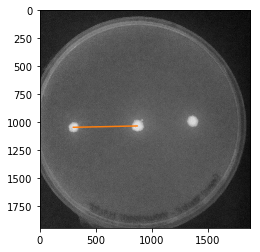

[]
/Users/jorgeriverosvergara/Desktop/Universidad/10ºSemestre/Biologia Sintetica y Prototipado de Funciones Artificiales/Proyecto/biosync/Drops/All/LBKAN_3G_c6.jpg
LBKAN_3G_c6.jpg
[35.355339059327378, 42.426406871192853, 14.142135623730951, 42.426406871192853]
[1075.6588678572775, 557.10860700585124, 110.92339699089638, 0.0]
[35.355339059327378, 42.426406871192853, 14.142135623730951, 42.426406871192853]
[1075.6588678572775, 557.10860700585124, 110.92339699089638, 0.0]


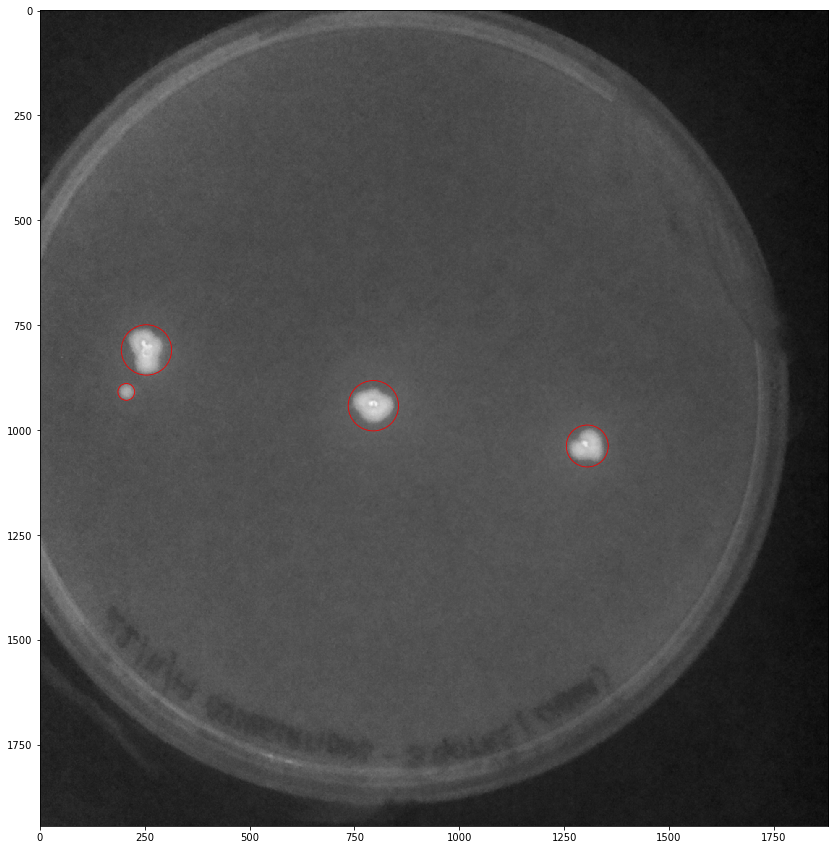

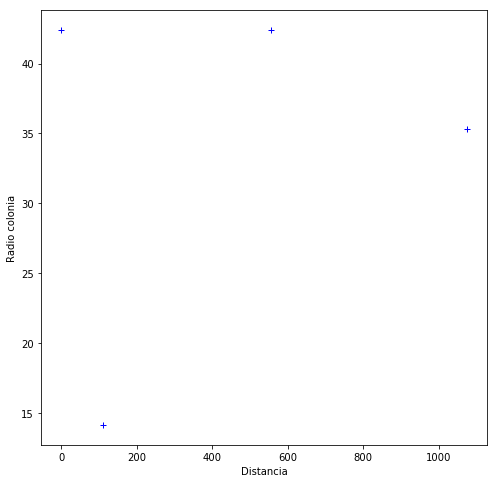

[[ 1038.  1305.    25.]
 [  942.   795.    30.]
 [  909.   206.    10.]
 [  809.   254.    30.]]


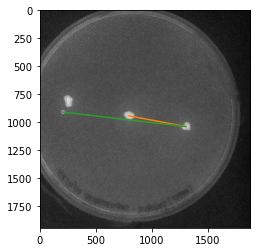

[]
/Users/jorgeriverosvergara/Desktop/Universidad/10ºSemestre/Biologia Sintetica y Prototipado de Funciones Artificiales/Proyecto/biosync/Drops/All/LBKAN_4G_0.jpg
LBKAN_4G_0.jpg
[35.355339059327378, 42.426406871192853, 42.426406871192853, 42.426406871192853]
[877.03648726834626, 583.88783169372527, 634.6038134143223, 0.0]
[35.355339059327378, 42.426406871192853, 42.426406871192853, 42.426406871192853]
[877.03648726834626, 583.88783169372527, 634.6038134143223, 0.0]


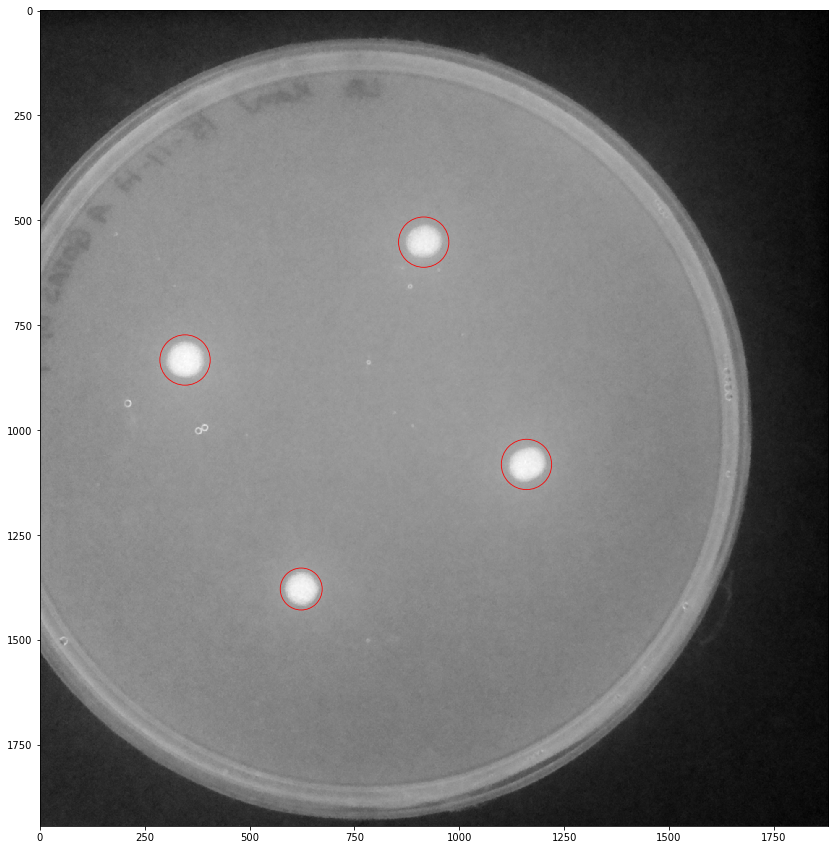

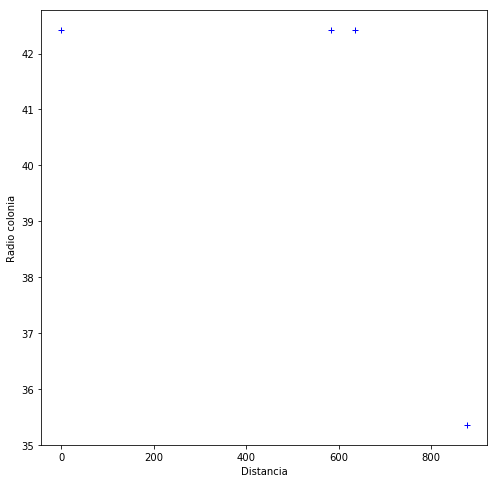

[[ 1379.   623.    25.]
 [ 1082.  1160.    30.]
 [  833.   346.    30.]
 [  552.   915.    30.]]


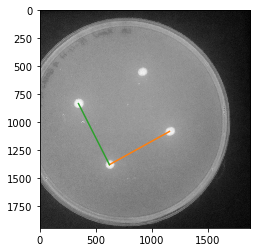

[]
/Users/jorgeriverosvergara/Desktop/Universidad/10ºSemestre/Biologia Sintetica y Prototipado de Funciones Artificiales/Proyecto/biosync/Drops/All/LBKAN_4G_1.jpg
LBKAN_4G_1.jpg
[35.355339059327378, 35.355339059327378, 35.355339059327378, 35.355339059327378]
[854.38457383077787, 617.43015799359853, 588.37488049711976, 0.0]
[35.355339059327378, 35.355339059327378, 35.355339059327378, 35.355339059327378]
[854.38457383077787, 617.43015799359853, 588.37488049711976, 0.0]


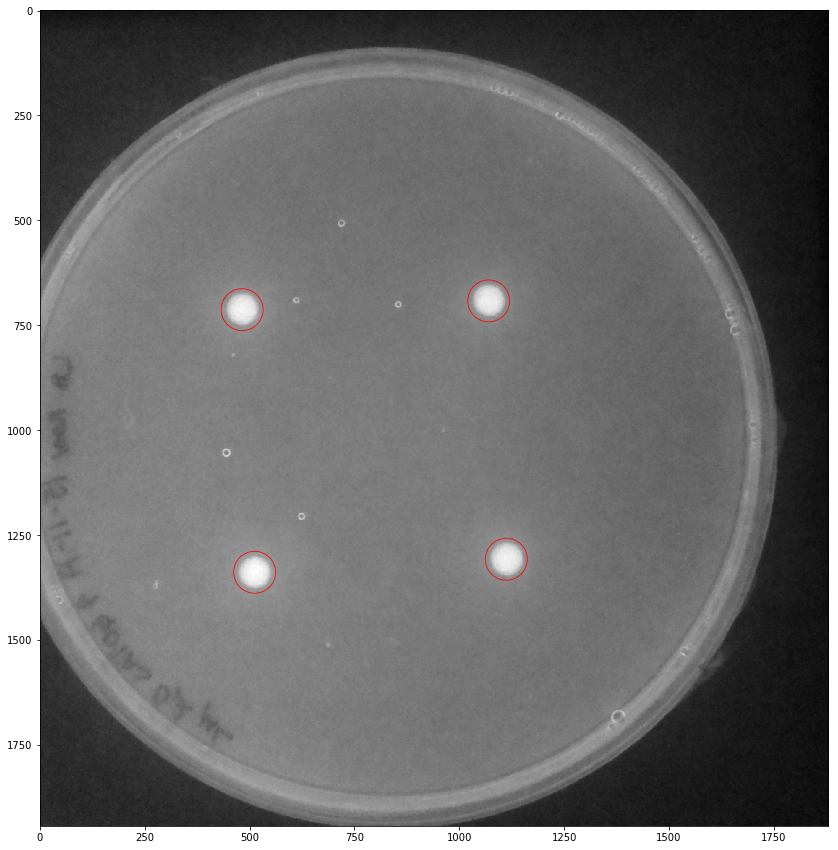

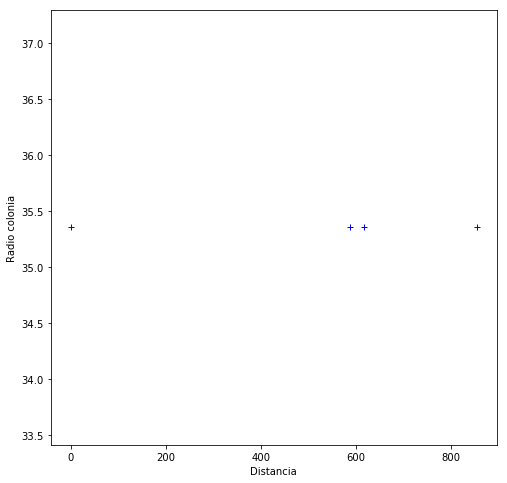

[[ 1339.   512.    25.]
 [ 1308.  1112.    25.]
 [  713.   482.    25.]
 [  692.  1070.    25.]]


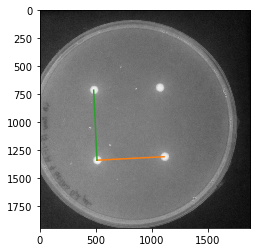

[]
/Users/jorgeriverosvergara/Desktop/Universidad/10ºSemestre/Biologia Sintetica y Prototipado de Funciones Artificiales/Proyecto/biosync/Drops/All/LBKAN_4G_1c.jpg
LBKAN_4G_1c.jpg
[35.355339059327378, 35.355339059327378, 28.284271247461902, 35.355339059327378]
[801.17476245822922, 793.07628889029331, 467.48796775959914, 0.0]
[35.355339059327378, 35.355339059327378, 28.284271247461902, 35.355339059327378]
[801.17476245822922, 793.07628889029331, 467.48796775959914, 0.0]


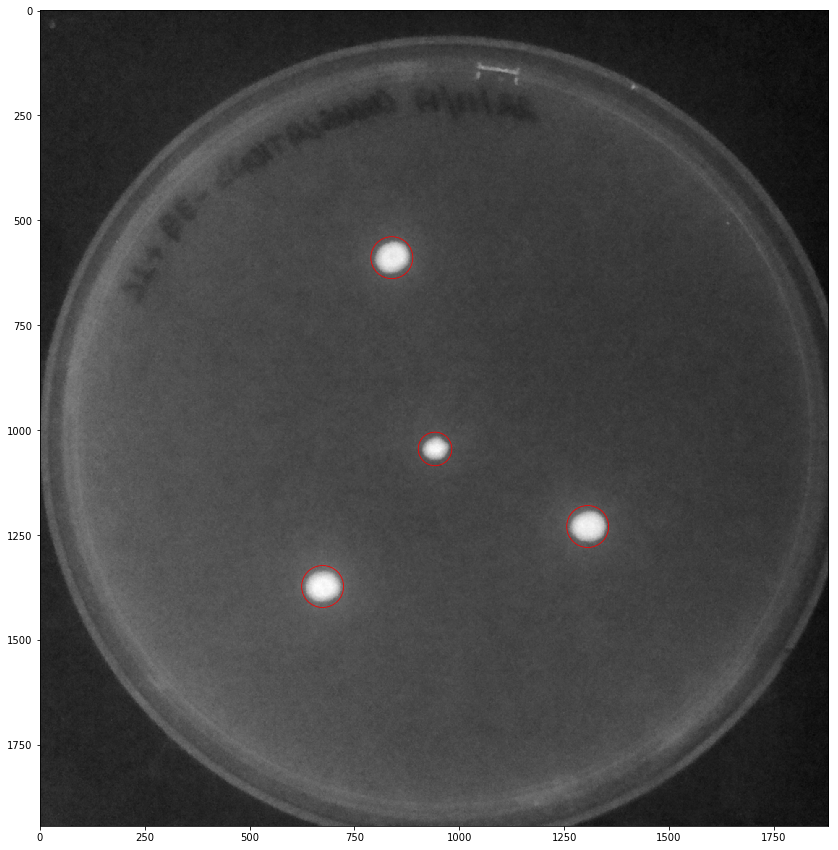

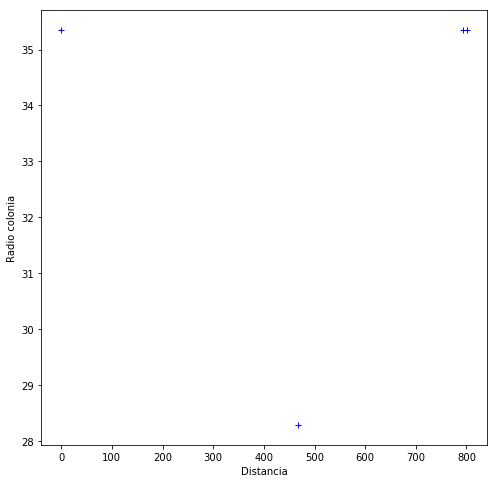

[[ 1373.   674.    25.]
 [ 1230.  1306.    25.]
 [ 1045.   942.    20.]
 [  589.   839.    25.]]


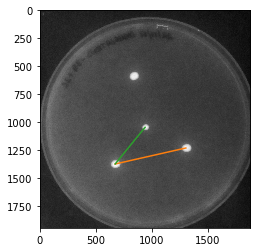

[]
/Users/jorgeriverosvergara/Desktop/Universidad/10ºSemestre/Biologia Sintetica y Prototipado de Funciones Artificiales/Proyecto/biosync/Drops/All/LBKAN_4G_2.jpg
LBKAN_4G_2.jpg
[35.355339059327378, 35.355339059327378, 35.355339059327378, 35.355339059327378]
[865.70780289887648, 613.17615739687722, 664.19650706699747, 0.0]
[35.355339059327378, 35.355339059327378, 35.355339059327378, 35.355339059327378]
[865.70780289887648, 613.17615739687722, 664.19650706699747, 0.0]


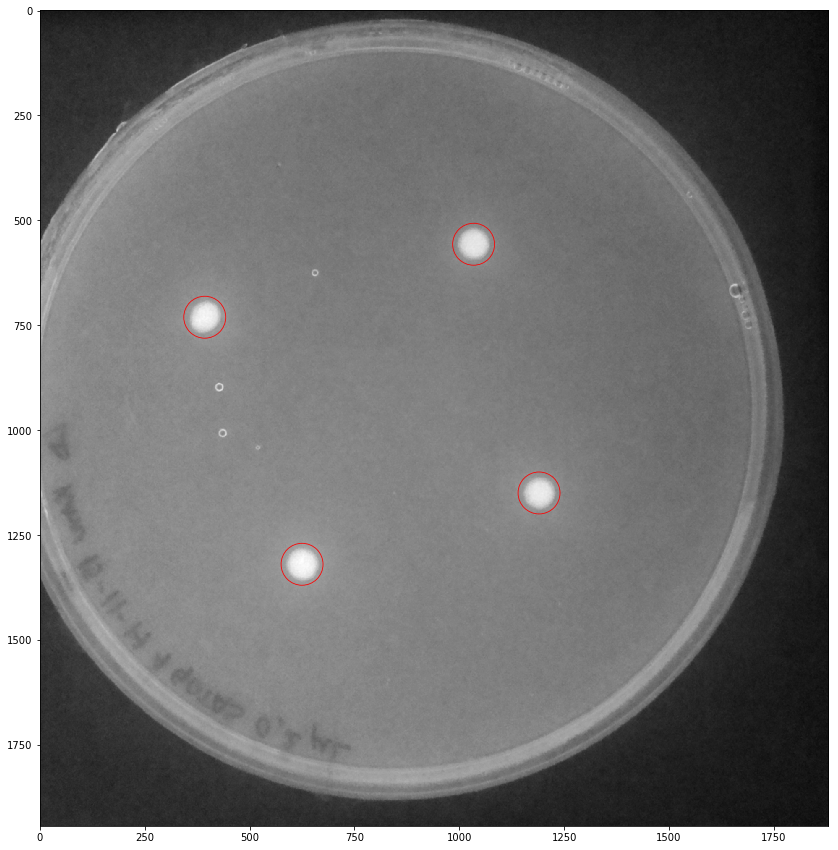

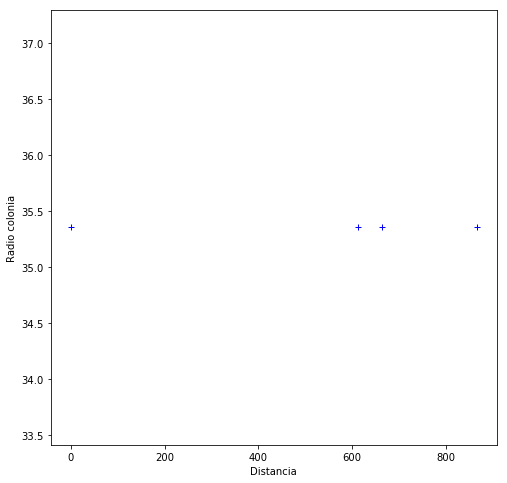

[[ 1320.   625.    25.]
 [ 1150.  1190.    25.]
 [  731.   393.    25.]
 [  557.  1034.    25.]]


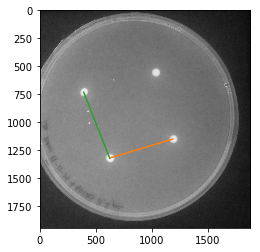

[]
/Users/jorgeriverosvergara/Desktop/Universidad/10ºSemestre/Biologia Sintetica y Prototipado de Funciones Artificiales/Proyecto/biosync/Drops/All/LBKAN_4G_3.jpg
LBKAN_4G_3.jpg
[28.284271247461902, 35.355339059327378, 35.355339059327378, 28.284271247461902]
[892.86617138292343, 597.19762223237296, 745.20131508203872, 0.0]
[28.284271247461902, 35.355339059327378, 35.355339059327378, 28.284271247461902]
[892.86617138292343, 597.19762223237296, 745.20131508203872, 0.0]


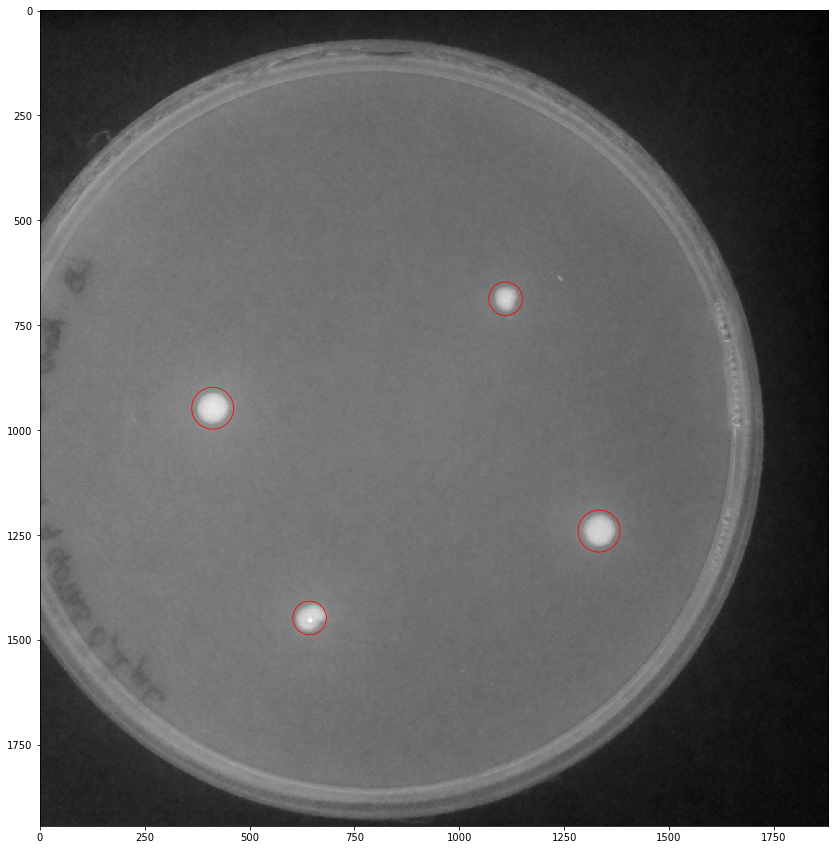

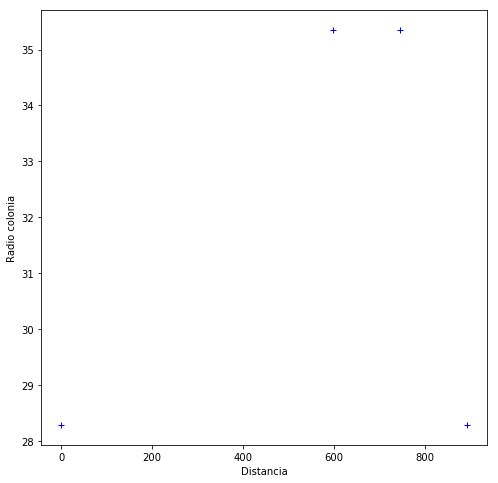

[[ 1448.   643.    20.]
 [ 1241.  1333.    25.]
 [  948.   412.    25.]
 [  687.  1110.    20.]]


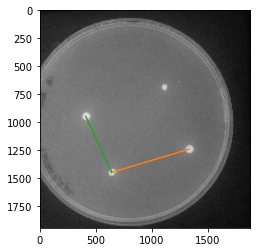

[]
/Users/jorgeriverosvergara/Desktop/Universidad/10ºSemestre/Biologia Sintetica y Prototipado de Funciones Artificiales/Proyecto/biosync/Drops/All/LBKAN_4G_4.jpg
LBKAN_4G_4.jpg
[28.284271247461902, 35.355339059327378, 35.355339059327378, 35.355339059327378]
[858.42879728024036, 577.47380892989429, 658.40565003651056, 0.0]
[28.284271247461902, 35.355339059327378, 35.355339059327378, 35.355339059327378]
[858.42879728024036, 577.47380892989429, 658.40565003651056, 0.0]


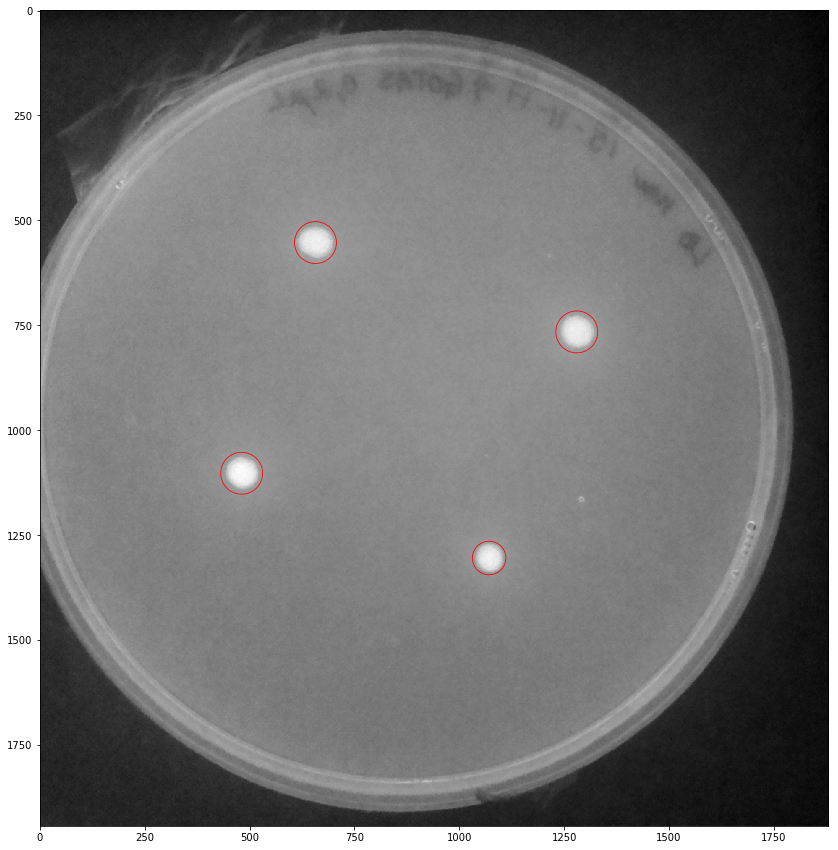

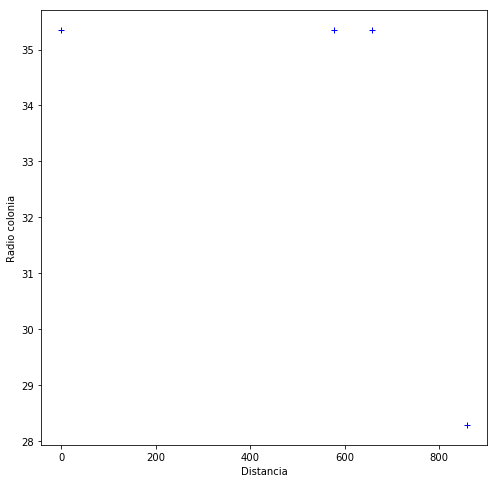

[[ 1305.  1071.    20.]
 [ 1103.   481.    25.]
 [  766.  1280.    25.]
 [  553.   657.    25.]]


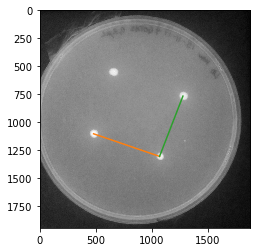

[]
/Users/jorgeriverosvergara/Desktop/Universidad/10ºSemestre/Biologia Sintetica y Prototipado de Funciones Artificiales/Proyecto/biosync/Drops/All/LBKAN_4G_5c.jpg
LBKAN_4G_5c.jpg
[42.426406871192853, 42.426406871192853, 35.355339059327378, 42.426406871192853]
[751.41732745525644, 777.33712120289226, 426.91919610155736, 0.0]
[42.426406871192853, 42.426406871192853, 35.355339059327378, 42.426406871192853]
[751.41732745525644, 777.33712120289226, 426.91919610155736, 0.0]


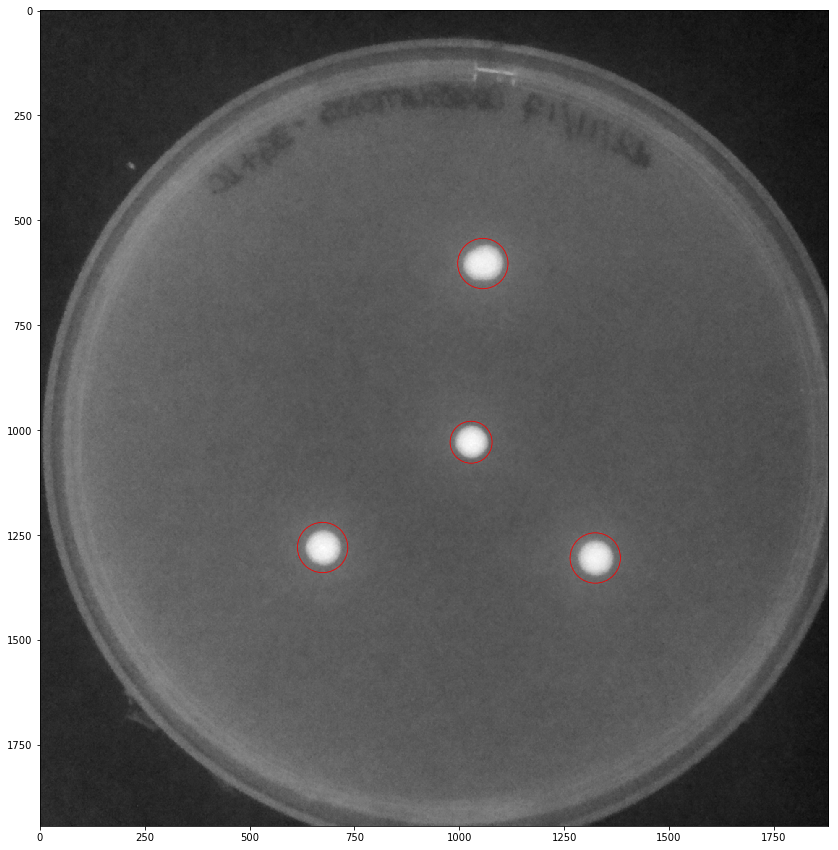

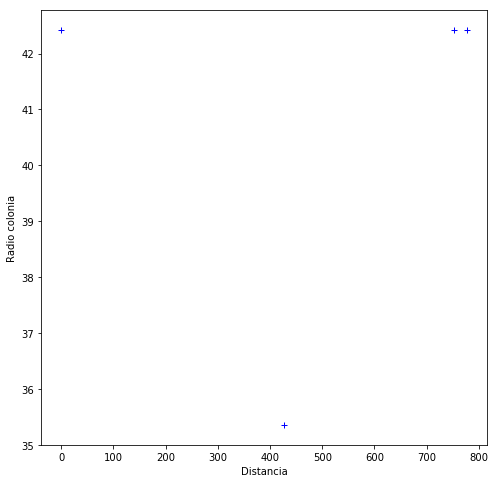

[[ 1305.  1324.    30.]
 [ 1280.   674.    30.]
 [ 1029.  1028.    25.]
 [  603.  1056.    30.]]


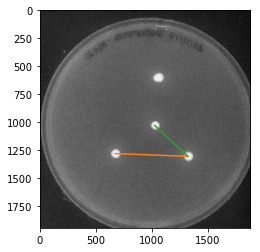

[]
/Users/jorgeriverosvergara/Desktop/Universidad/10ºSemestre/Biologia Sintetica y Prototipado de Funciones Artificiales/Proyecto/biosync/Drops/All/LBKAN_4G_6c.jpg
LBKAN_4G_6c.jpg
[35.355339059327378, 35.355339059327378, 42.426406871192853, 42.426406871192853]
[765.62196938175691, 791.82384404613629, 429.16779935125606, 0.0]
[35.355339059327378, 35.355339059327378, 42.426406871192853, 42.426406871192853]
[765.62196938175691, 791.82384404613629, 429.16779935125606, 0.0]


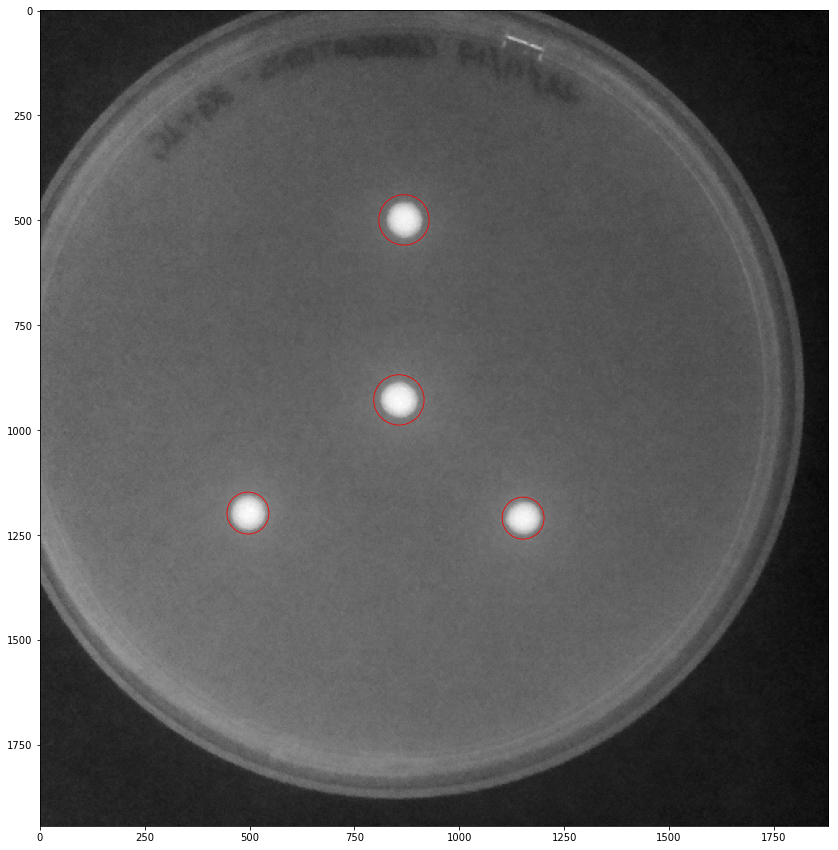

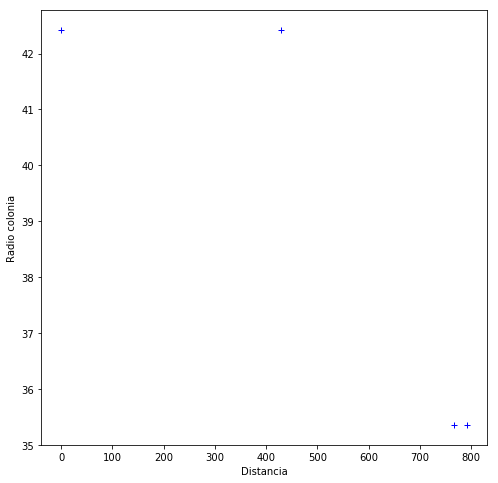

[[ 1210.  1152.    25.]
 [ 1198.   496.    25.]
 [  928.   856.    30.]
 [  499.   868.    30.]]


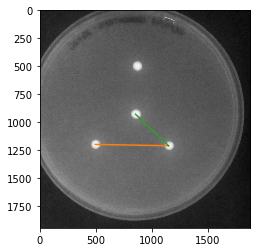

[]
/Users/jorgeriverosvergara/Desktop/Universidad/10ºSemestre/Biologia Sintetica y Prototipado de Funciones Artificiales/Proyecto/biosync/Drops/All/LBKAN_5G_0.jpg
LBKAN_5G_0.jpg


In [ ]:
mini = 0
maxi = 45

rad_all = []
dist_all = []
list_n = []
for i in range(mini, maxi):
    
    filename = archivos[i]
    arname = filename[145:]
    print(filename)
    print(arname)
    
    imagefile = plt.imread(filename)
    #print(imagefile.shape)
    #plt.imshow(imagefile, aspect='equal')
    
    image_sum = imagefile.sum(axis=2)
    #plt.imshow(image_sum)
    #plt.colorbar()
    
    from skimage.filters import gaussian
    g_image = gaussian(imagefile[:, 220:2100, 1], 1)
    ng_image = (g_image-g_image.min())/(g_image.max()-g_image.min())
    #plt.imshow(ng_image)
    #plt.colorbar()
    
    import skimage.feature as skfeat
    A = skfeat.blob_log(ng_image, min_sigma=5.0, max_sigma=75.0, num_sigma=15, threshold=0.16, overlap=0.8)
    #print(A.shape)
    #print(A[0:5, :])
    
    #plt.figure(figsize=(15, 15))
    #plt.imshow(ng_image, cmap='gray')
    #plt.hold(True)
    #for i in range(len(A)):
    #    plt.plot(A[i, 1], A[i, 0], 'r+')
        
    plt.figure(figsize=(15, 15))
    plt.imshow(ng_image, cmap='gray')
    #plt.hold(True)
    for i in range(len(A)):
        circle = plt.Circle((A[i, 1], A[i, 0]), 2*A[i, 2], color='r', fill=False, lw=0.8)
        fig = plt.gcf()
        ax = fig.gca()
        ax.add_artist(circle)
        
    #A : (n, 3) ndarray for n blobs detected
    #A 2d array with each row representing 3 values, (y,x,sigma) 
    #where (y,x) are coordinates of the blob 
    #and sigma is the standard deviation of the Gaussian kernel which detected the blob.
    #The radius of each blob is approximately sqrt(2)·sigma
    radius = []
    for data in A:
        radius.append(np.sqrt(2)*data[2])
        rad_all.append(np.sqrt(2)*data[2])
        list_n.append(len(A))
    print(radius)
        
    #A is the number of colonies detected in the image
    from scipy.spatial import distance
    nA = len(A)
    #print(len(A))
    R = np.arange(0, 2000, 100)
    #print(R)
    nR = len(R)
    #print(len(R))
    count = np.zeros((nA, nR))

    for c1 in range(nA):
        j = A[c1, 0:2]
        xj = j[0]
        yj = j[1]
        sj = A[c1, 2]

        for c2 in range(nA):
            l = A[c2, 0:2]
            xl = l[0]
            yl = l[1] 
            sl = A[c2, 2]
       
            d = distance.euclidean(j, l)
        
            with open('Datos_Imagen_%s.txt' %arname, 'a') as f:
        
                print("Colony 1X : %f, Colony 1Y : %f, Colony 2X : %f, Colony 2Y : %f, Distance : %f" % (xj, yj, xl, yl, d), file=f)
               
            for r in range(nR):
                if d < R[r]:
                    count[c1, r] += 1                
    #print(count[:, :])
    #print(count.transpose())

    #np.savetxt('Count_Imagen_%s.csv' %arname, count, fmt='%i', delimiter=",")
    
    #fig1 = plt.figure(figsize=(5, 5), dpi=150)
    #plt.plot(count.transpose())
    #plt.xlabel('nR')
    #plt.ylabel('Number of Colonies')
    #plt.title('Number of Colonies detected at each Radius')
    #plt.savefig('Gráfico_1_%s.png' %arname)
    #plt.show()
    
    def distanceBLOB(blobs,central): #inserta blobD e indice de el blob a investigar (lo ultimo le da flexibilidad para el futuro)
        distcenter = np.sqrt(((blobs[0]-central[0])**2)+((blobs[1]-central[1])**2))
        #plt.plot([central[1],blobs[1]],[central[0],blobs[0]])
        return distcenter

    for c in range(0, len(A)):
        distcen = []
        plt.figure(figsize=(8,8))
        for element in A:
            distcen.append(distanceBLOB(element,A[c])) #2 por ejemplo
            dist_all.append(distanceBLOB(element,A[c]))
        #plt.imshow(ng_image, cmap='gray')
        #plt.show()

    print(distcen)
    
    print(radius)
    print(distcen)
    plt.plot(distcen, radius, "b+")
    plt.xlabel("Distancia")
    plt.ylabel("Radio colonia")
    plt.show()
    
    def distanceBLOB(blobs,central): #inserta blobD e indice de el blob a investigar (lo ultimo le da flexibilidad para el futuro)
        distcenter = np.sqrt(((blobs[0]-central[0])**2)+((blobs[1]-central[1])**2))    
        plt.plot([central[1],blobs[1]],[central[0],blobs[0]])
        return distcenter

    #IMPORTANTE, ESTE CODIGO NO CONSIDERARA CADA UNA DE NUESTRAS IMAGENES COMO DISTINTAS, NUESTRO RADIO ES DISTINTO PARA
    #CADA IMAGEN, NUESTRAS DISTANCIAS SON "DISTINTAS" PARA CADA IMAGEN Y ESO ES LO QUE CORRELACIONAMOS PARA CADA INTENTO
    #DEL EXPERIMENTO, POR LO CUAL FLUOPI, QUE USA TIMELAPSES, PARA --LAS MISMAS PLACAS-- NO NOS SIRVE.
    distrad = []
    distcen = []
    #radius = r_fit
    #plt.figure(figsize=(8,8))
    i = 0
    avdist = 0
    avrad = 0

    #(y,x,sigma)
    print(A) 

    for element in A:
        i += 1
        if i >= len(A):
            continue
        central = 0 #por ejemplo
        distances = distanceBLOB(element,A[central])
        distrad.append([distances,radius[i], radius[central],len(A)]) #distrad es [distancia,radiosatelite,radiocentral,numerodeblobs] 
        avdist += distances/len(A)
        avrad +=radius[central]/len(A)

    
    '''
    for element in distrad:
        xi,xp = element[2],avdrad
        yi,yp = element[0],avdist
        aux1 += (xi-xp)*(yi-yp)
        aux2 +=
        aux3 += (xi-xp)*(yi-yp),np.sqrt((xi-xp)**2)),np.sqrt((yi-yp)**2)
    
    correlation = aux1/(aux2*aux3)
    '''
    #aca tenemos una correlacion para 1 n, luego lo hacemos para multiples n y graficamos n versus correlacion, encon-
    #trando como varia el crecimiento de las baterias dependiendo del numero de bacterias satelites
    #Ademas si la curva es bonita, podemos modelarle una curva y asi predecir para cualquier n y aplicarlo a cualquier
    #muestra y cualquier colonia centrar.

    plt.imshow(ng_image, cmap='gray')
    plt.show()
    print(distcen)

In [101]:
print(rad_all)
print(dist_all)

[42.426406871192853, 35.355339059327378, 35.355339059327378, 35.355339059327378, 28.284271247461902, 21.213203435596427, 21.213203435596427, 49.497474683058329, 35.355339059327378, 35.355339059327378, 35.355339059327378, 35.355339059327378, 42.426406871192853, 35.355339059327378, 35.355339059327378, 35.355339059327378, 35.355339059327378, 35.355339059327378, 42.426406871192853, 35.355339059327378, 35.355339059327378, 28.284271247461902, 35.355339059327378, 35.355339059327378, 42.426406871192853, 35.355339059327378, 35.355339059327378, 14.142135623730951, 14.142135623730951, 35.355339059327378, 35.355339059327378, 35.355339059327378, 35.355339059327378, 35.355339059327378, 42.426406871192853, 35.355339059327378, 35.355339059327378, 42.426406871192853, 42.426406871192853, 35.355339059327378, 35.355339059327378, 42.426406871192853, 49.497474683058329, 35.355339059327378, 42.426406871192853, 42.426406871192853, 42.426406871192853, 21.213203435596427, 49.497474683058329, 42.426406871192853,

In [85]:
dist_all = list(filter(lambda a: a != 0, dist_all))
rad_all = list(filter(lambda a: a > 20, rad_all))

from  more_itertools import unique_everseen
dist_all= list(unique_everseen(dist_all))

In [107]:
#del dist_all[851:]
rrr = rad_all*5
del rrr[851:]

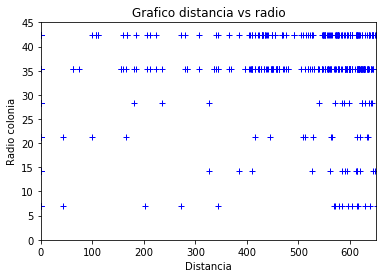

In [108]:
plt.plot(dist_all, rrr, "b+")
plt.xlabel("Distancia")
plt.ylabel("Radio colonia")
plt.title("Grafico distancia vs radio")
plt.ylim([0,45])
plt.xlim([0,650])
plt.savefig('Gráfico_LBKAN_XG.png')
plt.show()


<function matplotlib.pyplot.show>

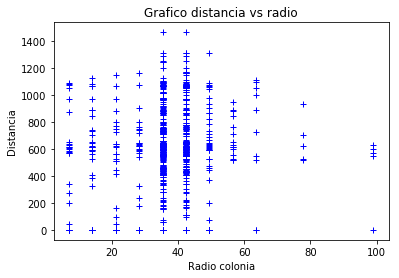

In [110]:
plt.plot(rrr, dist_all, "b+")
plt.ylabel("Distancia")
plt.xlabel("Radio colonia")
plt.title("Grafico distancia vs radio")
#plt.ylim([0,45])
#plt.xlim([0,650])
plt.show

In [125]:
n = len(rrr)
n2 = len(dist_all)
aux1 = 0
aux2 = np.power(dist_all,2)
aux3 = np.power(np.sum(dist_all),2)
aux4 = np.power(rrr,2)
aux5 = np.power(np.sum(rrr),2)

aux6 = np.sum(aux2) - aux3
aux7 = np.sum(aux4) - aux5

for dist in dist_all:
    for rad in rrr:
        aux1 += dist*rad
        
correlation = (aux1 - np.sum(dist_all)*np.sum(rrr))/(np.sqrt(aux6*aux7))
print(correlation)


2.6933247937e-13
